# Cost-function dependent Barren Plateaus in Born Policies 

### Contents

PART I - Born policies 
1. [Random circuit with nearest neighbour entangling single layer](#random)
2. [Rx parameterized model presented in Cost function barren plateaus](#rx)
3. [Rx with Log Policy](#rxlog)
4. [Strongly Entangling Layer](#SEL)
5. [Strongly Entangling Layers](#SELLayers)
6. [Random circuit with multiple layers](#randomlayers)
7. [Simplified two-design](#2-design)

PART II - Generalized Born policies 
1. [Simplified two design](#general-2-design)

In [1]:
import pennylane as qml
#from pennylane import numpy as np
import numpy as np
import numpy.linalg as linalg
import matplotlib.pyplot as plt
import torch


# PART I - Born policies
### Born policies from single basis state 

## 1. Random circuit with nearest neighbour entangling single layer <a name="random"></a>
### Separable state 

In [22]:
qubits = [2, 3, 4, 5, 6, 8, 10]
variances_global = []
variances_local = []
exp_global=[]
exp_local=[]
num_samples = 1000

for n_qubits in qubits:
    print("number of qubits - ", n_qubits)
    grad_vals_global = []
    grad_vals_local = []
    for i in range(num_samples):
        dev = qml.device("default.qubit", wires=n_qubits)
        dev2 = qml.device("default.qubit", wires=n_qubits)

        gate_set = [qml.RX, qml.RY, qml.RZ]
        random_gate_sequence = {i: np.random.choice(gate_set) for i in range(n_qubits)}

        @qml.qnode(dev, interface="torch", diff_method="backprop")
        def rand_circuit_global(params):
            
            for i in range(n_qubits):
                qml.RY(np.pi / 4, wires=i)

            for i in range(n_qubits):
                random_gate_sequence[i](params[i], wires=i)

            #for i in range(n_qubits - 1):
                #qml.CZ(wires=[i, i + 1])
            H = np.zeros((2 ** n_qubits, 2 ** n_qubits))
            H[0, 0] = 1

            wirelist = [i for i in range(n_qubits)]
            #return qml.expval(qml.Hermitian(H, wirelist))
            return qml.probs(wires=range(n_qubits))

        @qml.qnode(dev2, interface="torch", diff_method="backprop")
        def rand_circuit_local(params,qubit=0):

            for i in range(n_qubits):
                qml.RY(np.pi / 4, wires=i)

            for i in range(n_qubits):
                random_gate_sequence[i](params[i], wires=i)

            #for i in range(n_qubits - 1):
                #qml.CZ(wires=[i, i + 1])


            #return [qml.probs(i) for i in range(n_qubits)]
            return qml.probs(wires=qubit)
            
            #return qml.probs(wires=range(num_qubits))

        def global_loss(params):
            probs = rand_circuit_global(params)[0]
            #return np.log(probs)
            return torch.log(probs)
            #return 1 - probs

        def local_loss(params):
            probs = torch.stack([rand_circuit_local(params,qubit=i)[0] for i in range(n_qubits)])
            #probs = rand_circuit_local(params)

            #return np.log(np.prod(probs))
            return torch.log(torch.mean(probs))
            #return 1 - torch.mean(probs)
            #return 1 - np.prod(probs[:,0])
            
        #params = np.random.random(size=n_qubits, requires_grad = True)
        w = np.random.random(size=n_qubits)
        params = torch.tensor(w, requires_grad = True)
        params2 = torch.tensor(w, requires_grad = True)
        #grad_global = qml.grad(global_loss,argnum=0)#(params)
        #grad_vals_global.append(np.mean(grad_global(params)))#grad_global))
        global_cost = global_loss(params)
        global_cost.backward()
        grad_global = params.grad
        #grad_vals_global.append(np.mean(grad_global.numpy()))#grad_global))
        grad_vals_global.append(linalg.norm(grad_global.numpy()))#grad_global))

        local_cost = local_loss(params2)
        local_cost.backward()
        grad_local = params2.grad
        #grad_vals_local.append(np.mean(grad_local.numpy()))#grad_global))
        grad_vals_local.append(linalg.norm(grad_local.numpy()))#grad_global))

    variances_global.append(np.var(grad_vals_global))
    variances_local.append(np.var(grad_vals_local))
    exp_global.append(np.mean(grad_vals_global))
    exp_local.append(np.mean(grad_vals_local))

variances_global = np.array(variances_global)
variances_local = np.array(variances_local)
qubits = np.array(qubits)


number of qubits -  2
number of qubits -  3
number of qubits -  4
number of qubits -  5
number of qubits -  6
number of qubits -  8
number of qubits -  10


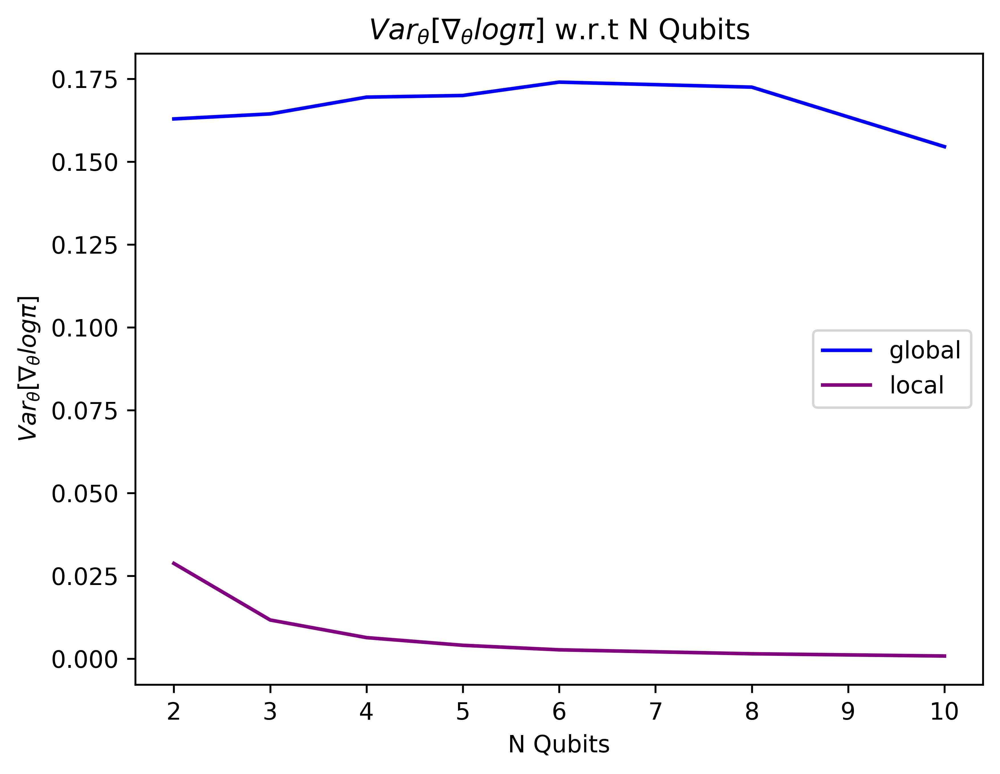

In [23]:
variances_global = np.array(variances_global)
variances_local = np.array(variances_local)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 600
plt.rcParams['savefig.dpi'] = 600
plt.plot(qubits,variances_global, color="blue", label="global")
plt.plot(qubits,variances_local, color="purple", label="local")
plt.legend()
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits")
plt.show()

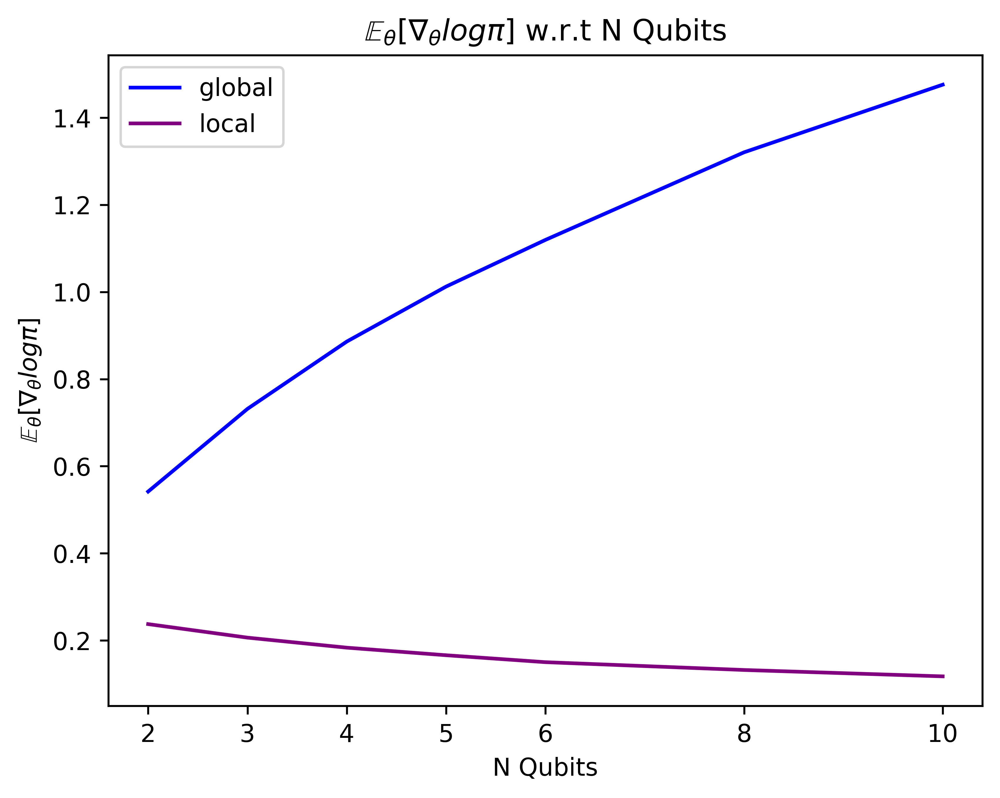

In [24]:
exp_global = np.array(exp_global)
exp_local = np.array(exp_local)
#variances_local_normal = np.array(variances_local_normal)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 600
plt.rcParams['savefig.dpi'] = 600
plt.plot(qubits,exp_global, color="blue", label="global")
plt.plot(qubits,exp_local, color="purple", label="local")
#plt.plot(qubits,variances_local_normal, color="darkorange" , label="local normal(0,1)")
plt.legend()
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

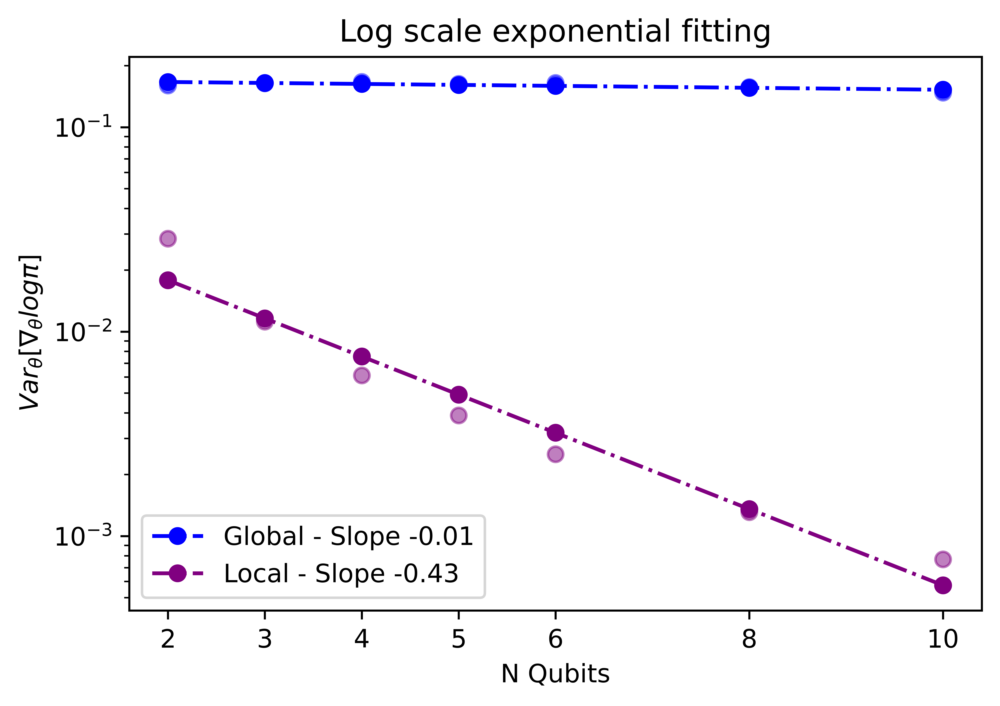

In [6]:
p = np.polyfit(qubits, np.log(variances_global), 1)
p2 = np.polyfit(qubits, np.log(variances_local), 1)

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.semilogy(qubits, variances_global, "o" , color="blue" , alpha=0.5)
plt.semilogy(qubits, np.exp(p[0] * qubits + p[1]), "o-.", color="blue", label="Global - Slope {:3.2f}".format(p[0]))
plt.semilogy(qubits, variances_local, "o" , color="purple", alpha=0.5)
plt.semilogy(qubits,  np.exp(p2[0] * qubits + p2[1]), "o-.", color="purple", label="Local - Slope {:3.2f}".format(p2[0]))
plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.legend()
plt.title("Log scale exponential fitting")
plt.show()

## Example - Rx parameterized model presented in Cost function barren plateaus <a name="rx"></a>
Global $L(\theta) = 1 - \prod_{i=0}^{n-1} cos(\theta_i)^2$ 

Local $L(\theta) = 1 - \frac{1}{n}\sum_{i=0}^{n-1} cos(\theta_i)^2$

In [7]:
def grad_global(param):
    #return np.array([-2*np.tan(param[i]) for i in range(len(param))])
    grads = []
    for i in range(len(param)):
        den = 1
        for j in range(len(param)):
            if i != j:
                den *= np.cos(param[j])**2
        grads.append((2*np.cos(param[i])*np.sin(param[i])*den))
    return grads

def grad_local(param):
    den = np.sum(np.array([np.cos(p)**2 for p in param]))
    return np.array([(2*np.cos(param[i])*np.sin(param[i])) for i in range(len(param))])
    #return np.array([(-2*np.cos(param[i])*np.sin(param[i]))/den for i in range(len(param))])


In [9]:
qubits = [2, 3, 4, 5, 6, 8, 10,12,14,16,18,20]
variances_global = []
variances_local = []
exp_global = []
exp_local = []
variances_local_normal = []
num_samples = 1000

for n_qubits in qubits:
    print("number of qubits - ", n_qubits)
    grad_vals_global = []
    grad_vals_local = []
    #grad_vals_local_n = []
    for i in range(num_samples):
        w = np.random.random(size=n_qubits)
        wn = np.random.normal(0,1,size=n_qubits)
        #grad_vals_global.append(np.mean(grad_global(w)))#grad_global))
        grad_vals_global.append(linalg.norm(grad_global(w)))#grad_global))
        
        grad_vals_local.append(linalg.norm(grad_local(w)))#grad_global))
        #grad_vals_local.append(np.mean(grad_local(w)))#grad_global))
        #grad_vals_local_n.append(np.mean(grad_local(wn)))#grad_global))

    
    variances_global.append(np.var(grad_vals_global))
    variances_local.append(np.var(grad_vals_local))
    exp_global.append(np.mean(grad_vals_global))
    exp_local.append(np.mean(grad_vals_local))
    #variances_local_normal.append(np.var(grad_vals_local_n))

number of qubits -  2
number of qubits -  3
number of qubits -  4
number of qubits -  5
number of qubits -  6
number of qubits -  8
number of qubits -  10
number of qubits -  12
number of qubits -  14
number of qubits -  16
number of qubits -  18
number of qubits -  20


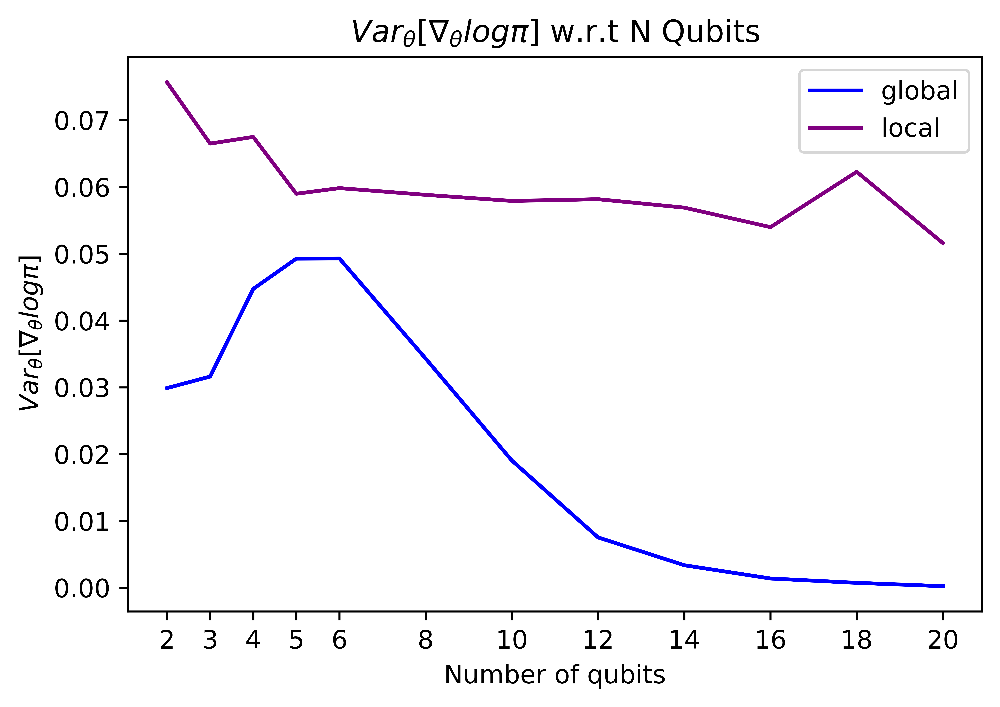

In [10]:
variances_global = np.array(variances_global)
variances_local = np.array(variances_local)
#variances_local_normal = np.array(variances_local_normal)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.plot(qubits,variances_global, color="blue", label="global")
plt.plot(qubits,variances_local, color="purple" , label="local")
#plt.plot(qubits,variances_local_normal, color="darkorange" , label="local normal(0,1)")
plt.legend()
plt.xlabel("Number of qubits")
plt.xticks(qubits)
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.show()

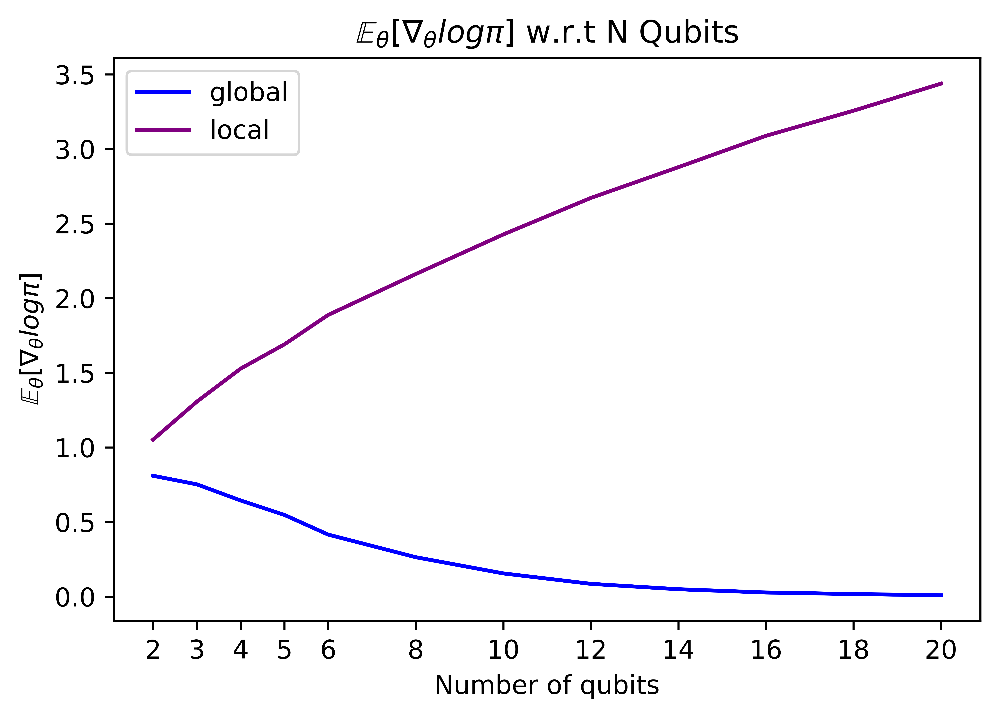

In [11]:
exp_global = np.array(exp_global)
exp_local = np.array(exp_local)
#variances_local_normal = np.array(variances_local_normal)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.plot(qubits,exp_global, color="blue", label="global")
plt.plot(qubits,exp_local, color="purple", label="local")
#plt.plot(qubits,variances_local_normal, color="darkorange" , label="local normal(0,1)")
plt.legend()
plt.xlabel("Number of qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

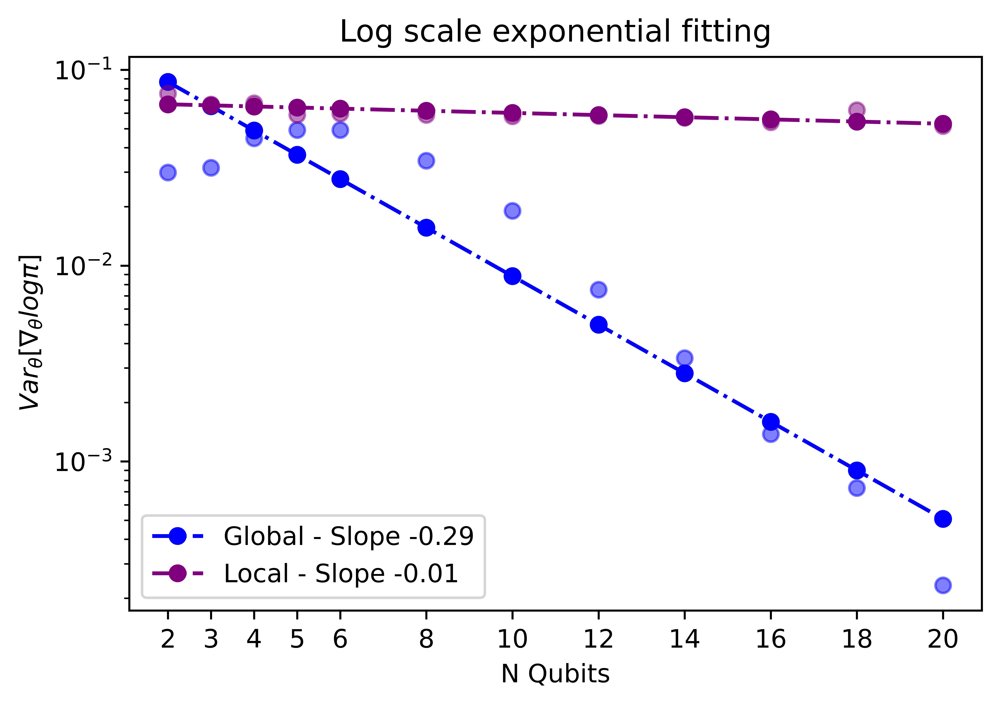

In [12]:
p = np.polyfit(qubits, np.log(variances_global), 1)
p2 = np.polyfit(qubits, np.log(variances_local), 1)
#p3 = np.polyfit(qubits, np.log(variances_local_normal), 1)

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.semilogy(qubits, variances_global, "o" , color="blue" , alpha=0.5)
plt.semilogy(qubits, np.exp(p[0] * qubits + p[1]), "o-.", color="blue", label="Global - Slope {:3.2f}".format(p[0]))
plt.semilogy(qubits, variances_local, "o" , color="purple", alpha=0.5)
plt.semilogy(qubits,  np.exp(p2[0] * qubits + p2[1]), "o-.", color="purple", label="Local - Slope {:3.2f}".format(p2[0]))
#plt.semilogy(qubits, variances_local_normal, "o" , color="darkorange",alpha=0.5)
#plt.semilogy(qubits,  np.exp(p3[0] * qubits + p3[1]), "o-.", color="darkorange", label="Local normal(0,1) - Slope {:3.2f}".format(p3[0]))
plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.legend()
plt.title("Log scale exponential fitting")
plt.show()

## Log policy <a name="rxlog"></a>
Global $\pi(\theta) = \prod_{i=0}^{n-1} cos(\theta_i)^2$ 

Local $\pi(\theta) = \frac{1}{n}\sum_{i=0}^{n-1} cos(\theta_i)^2$

In [2]:
def grad_global(param):
    #return np.array([-2*np.tan(param[i]) for i in range(len(param))])
    grads = [-2*np.tan(p) for p in param]
    return grads

def grad_local(param):
    grads = []
    for i in range(len(param)):
        den = 1
        for j in range(len(param)):
            if i != j:
                den *= np.cos(param[j])**2
        grads.append((2*np.cos(param[i])*np.sin(param[i])*den))
    return grads
    #return np.array([(-2*np.cos(param[i])*np.sin(param[i]))/den for i in range(len(param))])


In [19]:
qubits = [2, 3, 4, 5, 6, 8,10,12,14,16,18,20]
variances_global = []
#variances_global_normal = []
variances_local = []
#variances_local_normal = []
exp_global=[]
exp_local=[]
num_samples = 10000

for n_qubits in qubits:
    print("number of qubits - ", n_qubits)
    grad_vals_global = []
    #grad_vals_global_n = []
    grad_vals_local = []
    #grad_vals_local_n = []
    for i in range(num_samples):
        w = np.random.uniform(low=-np.pi, high=np.pi, size=n_qubits)
        wnt = np.random.normal(np.pi/4,1,size=n_qubits)
        wn = np.random.normal(0,n_qubits,size=n_qubits)
        grad_vals_global.append(linalg.norm(grad_global(w)))#grad_global))
        #grad_vals_global_n.append(linalg.norm(grad_global(wnt)))#grad_global))
        grad_vals_local.append(linalg.norm(grad_local(w)))#grad_global))
        #grad_vals_local_n.append(np.mean(grad_local(wn)))#grad_global))

    variances_global.append(np.var(grad_vals_global))
    #variances_global_normal.append(np.var(grad_vals_global_n))
    variances_local.append(np.var(grad_vals_local))
    exp_global.append(np.mean(grad_vals_global))
    exp_local.append(np.mean(grad_vals_local))

number of qubits -  2
number of qubits -  3
number of qubits -  4
number of qubits -  5
number of qubits -  6
number of qubits -  8
number of qubits -  10
number of qubits -  12
number of qubits -  14
number of qubits -  16
number of qubits -  18
number of qubits -  20


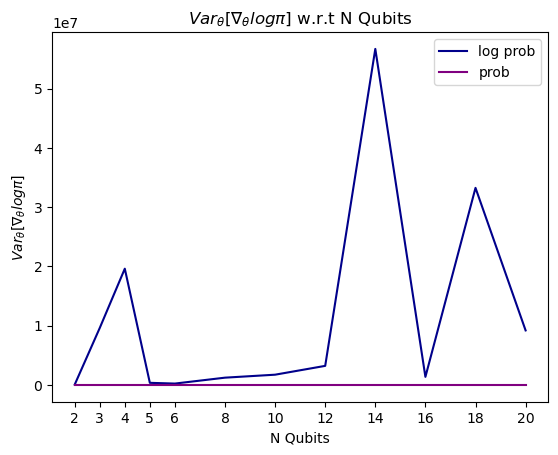

In [20]:
variances_global = np.array(variances_global)
#variances_global_normal = np.array(variances_global_normal)
variances_local = np.array(variances_local)
#variances_local_normal = np.array(variances_local_normal)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 600
plt.rcParams['savefig.dpi'] = 600
plt.style.use('default')
plt.plot(qubits,variances_global, color="darkblue", label="log prob")
#plt.plot(qubits,variances_global_normal, color="lightblue", label="global normal(0,1)")
plt.plot(qubits,variances_local, color="purple" , label="prob")
#plt.plot(qubits,variances_local_normal, color="darkorange" , label="local normal(0,1)")
plt.legend()
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.show()

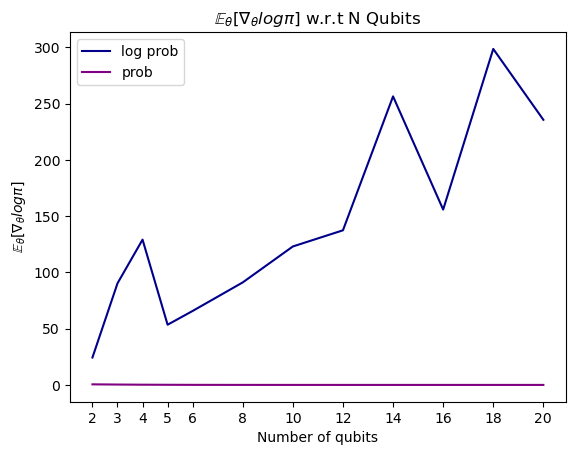

In [21]:
exp_global = np.array(exp_global)
exp_local = np.array(exp_local)
#variances_local_normal = np.array(variances_local_normal)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 600
plt.rcParams['savefig.dpi'] = 600
plt.style.use('default')
plt.plot(qubits,exp_global, color="darkblue", label="log prob")
plt.plot(qubits,exp_local, color="purple", label="prob")
#plt.plot(qubits,variances_local_normal, color="darkorange" , label="local normal(0,1)")
plt.legend()
plt.xlabel("Number of qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

In [270]:
-(2/0.99)*np.log(np.cos(0.99))

1.2125695233772695

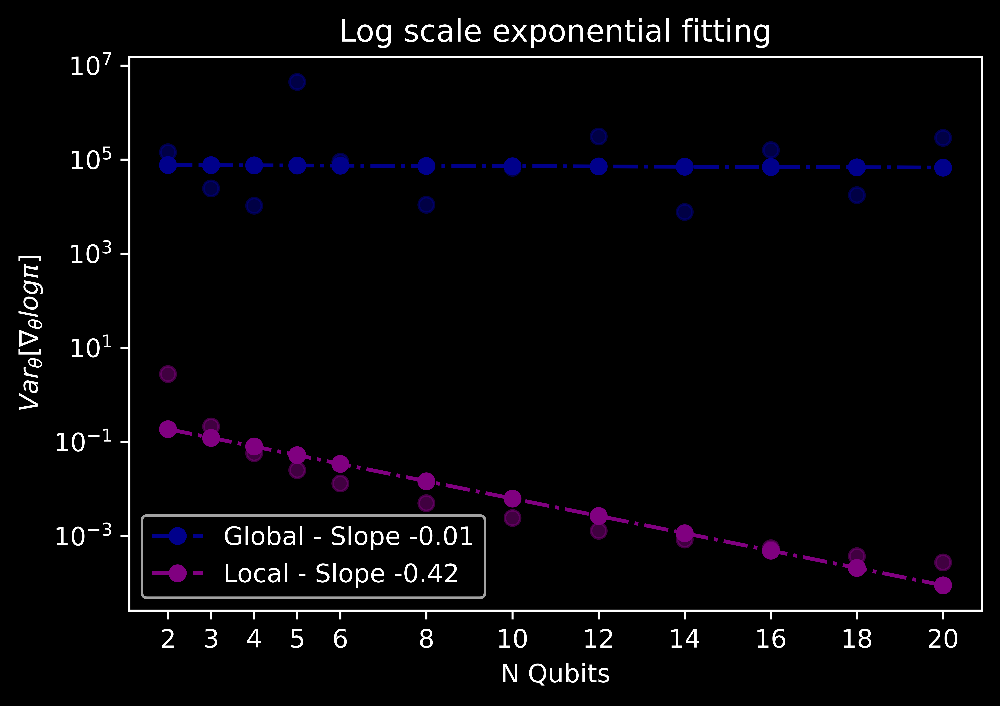

In [15]:
p = np.polyfit(qubits, np.log(variances_global), 1)
p2 = np.polyfit(qubits, np.log(variances_local), 1)
#p3 = np.polyfit(qubits, np.log(variances_local_normal), 1)

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.style.use('dark_background')
plt.semilogy(qubits, variances_global, "o" , color="darkblue" , alpha=0.5)
plt.semilogy(qubits, np.exp(p[0] * qubits + p[1]), "o-.", color="darkblue", label="Global - Slope {:3.2f}".format(p[0]))
plt.semilogy(qubits, variances_local, "o" , color="purple", alpha=0.5)
plt.semilogy(qubits,  np.exp(p2[0] * qubits + p2[1]), "o-.", color="purple", label="Local - Slope {:3.2f}".format(p2[0]))
#plt.semilogy(qubits, variances_local_normal, "o" , color="darkorange",alpha=0.5)
#plt.semilogy(qubits,  np.exp(p3[0] * qubits + p3[1]), "o-.", color="darkorange", label="Local normal(0,1) - Slope {:3.2f}".format(p3[0]))
plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.legend()
plt.title("Log scale exponential fitting")
plt.show()

## Strongly entangling layers single layer <a name="SEL"></a>

In [20]:
qubits = [2, 3, 4, 5, 6, 8, 10]
variances_global = []
variances_local = []
exp_global=[]
exp_local=[]
num_samples = 1000

for n_qubits in qubits:
    print("number of qubits - ", n_qubits)
    grad_vals_global = []
    grad_vals_local = []
    for i in range(num_samples):
        dev = qml.device("default.qubit", wires=n_qubits)
        dev2 = qml.device("default.qubit", wires=n_qubits)

        gate_set = [qml.RX, qml.RY, qml.RZ]
        random_gate_sequence = {i: np.random.choice(gate_set) for i in range(n_qubits)}

        @qml.qnode(dev, interface="torch", diff_method="backprop")
        def rand_circuit_global(params):
            
            qml.StronglyEntanglingLayers(weights=params, wires=range(n_qubits))

            return qml.probs(wires=range(n_qubits))

        @qml.qnode(dev2, interface="torch", diff_method="backprop")
        def rand_circuit_local(params,qubit=0):
                
            qml.StronglyEntanglingLayers(weights=params, wires=range(n_qubits))

            #return qml.probs(wires=qubit)
            return qml.expval(qml.Projector([0],wires=qubit))
            
        def global_loss(params):
            probs = rand_circuit_global(params)[0]
            #return np.log(probs)

            return torch.log(probs)
            #return 1 - probs

        def local_loss(params):
            probs = torch.stack([rand_circuit_local(params,qubit=i) for i in range(n_qubits)])
            #probs = rand_circuit_local(params)

            #return np.log(np.prod(probs))
            return torch.log(torch.mean(probs))
            #return 1 - torch.mean(probs)
            #return 1 - np.prod(probs[:,0])
            
        #params = np.random.random(size=n_qubits, requires_grad = True)
        shape = qml.StronglyEntanglingLayers.shape(n_layers=1, n_wires=n_qubits)
        weights = np.random.uniform(low=-np.pi, high=np.pi, size=shape)      
        params = torch.tensor(weights, requires_grad = True)
        params2 = torch.tensor(weights, requires_grad = True)
        #grad_global = qml.grad(global_loss,argnum=0)#(params)
        #grad_vals_global.append(np.mean(grad_global(params)))#grad_global))
        global_cost = global_loss(params)
        global_cost.backward()
        grad_global = params.grad
        grad_vals_global.append(linalg.norm(grad_global.numpy()))#grad_global))

        local_cost = local_loss(params2)
        local_cost.backward()
        grad_local = params2.grad
        grad_vals_local.append(linalg.norm(grad_local.numpy()))#grad_global))
    variances_global.append(np.var(grad_vals_global))
    variances_local.append(np.var(grad_vals_local))
    exp_global.append(np.mean(grad_vals_global))
    exp_local.append(np.mean(grad_vals_local))

variances_global = np.array(variances_global)
variances_local = np.array(variances_local)
qubits = np.array(qubits)


number of qubits -  2
number of qubits -  3
number of qubits -  4
number of qubits -  5
number of qubits -  6
number of qubits -  8
number of qubits -  10


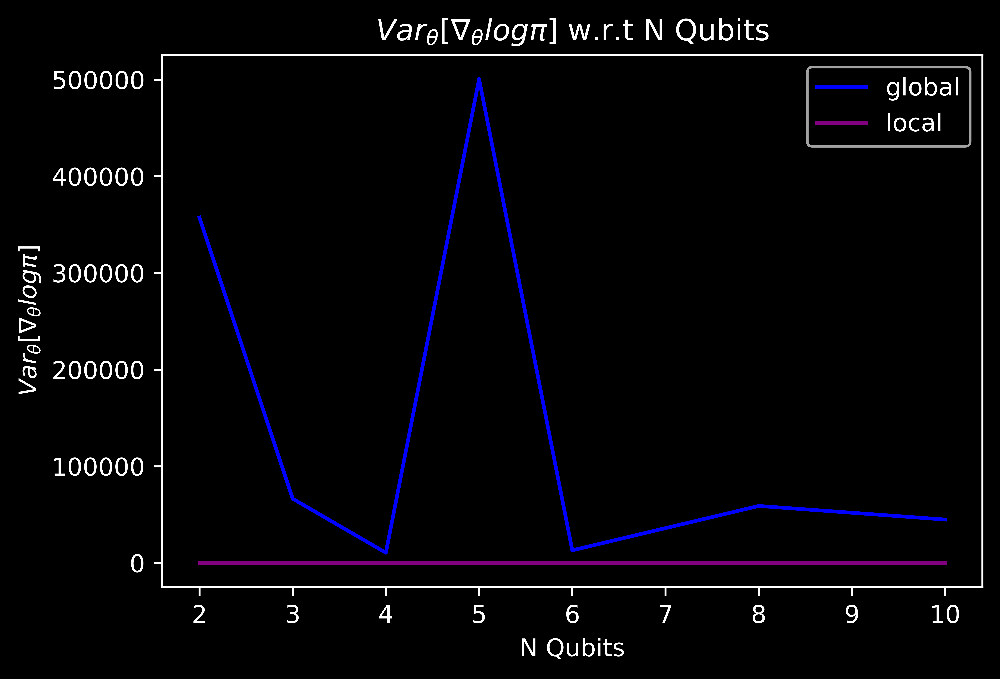

In [21]:
variances_global = np.array(variances_global)
variances_local = np.array(variances_local)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.plot(qubits,variances_global, color="blue", label="global")
plt.plot(qubits,variances_local, color="purple", label="local")
plt.legend()
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits")
plt.show()

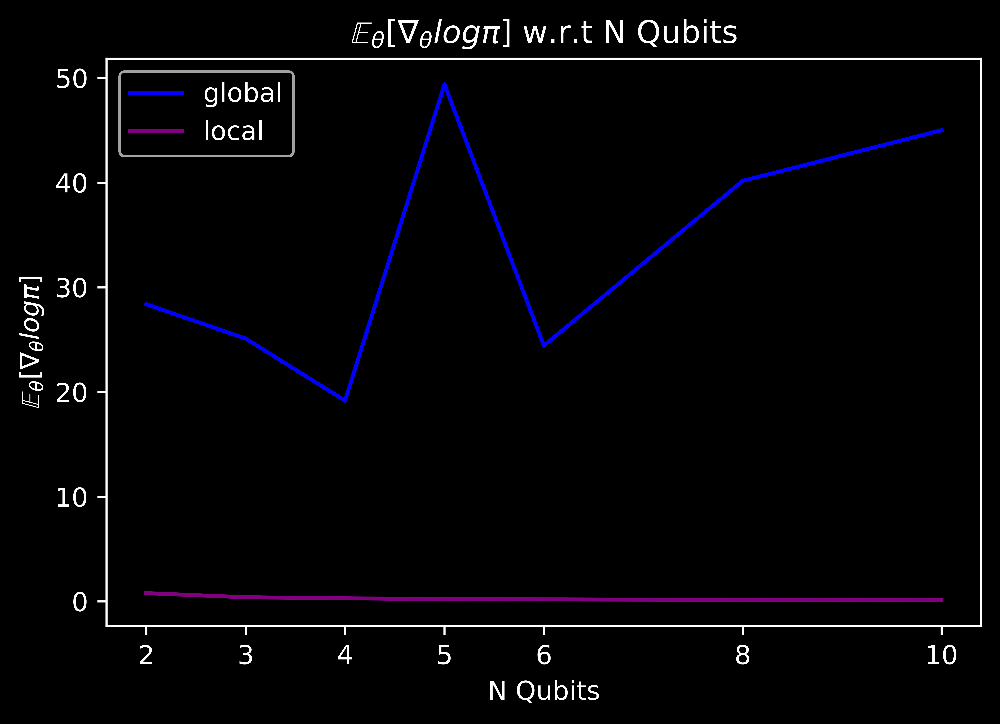

In [22]:
exp_global = np.array(exp_global)
exp_local = np.array(exp_local)
#variances_local_normal = np.array(variances_local_normal)
qubits = np.array(qubits)

plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.plot(qubits,exp_global, color="blue", label="global")
plt.plot(qubits,exp_local, color="purple", label="local")
#plt.plot(qubits,variances_local_normal, color="darkorange" , label="local normal(0,1)")
plt.legend()
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

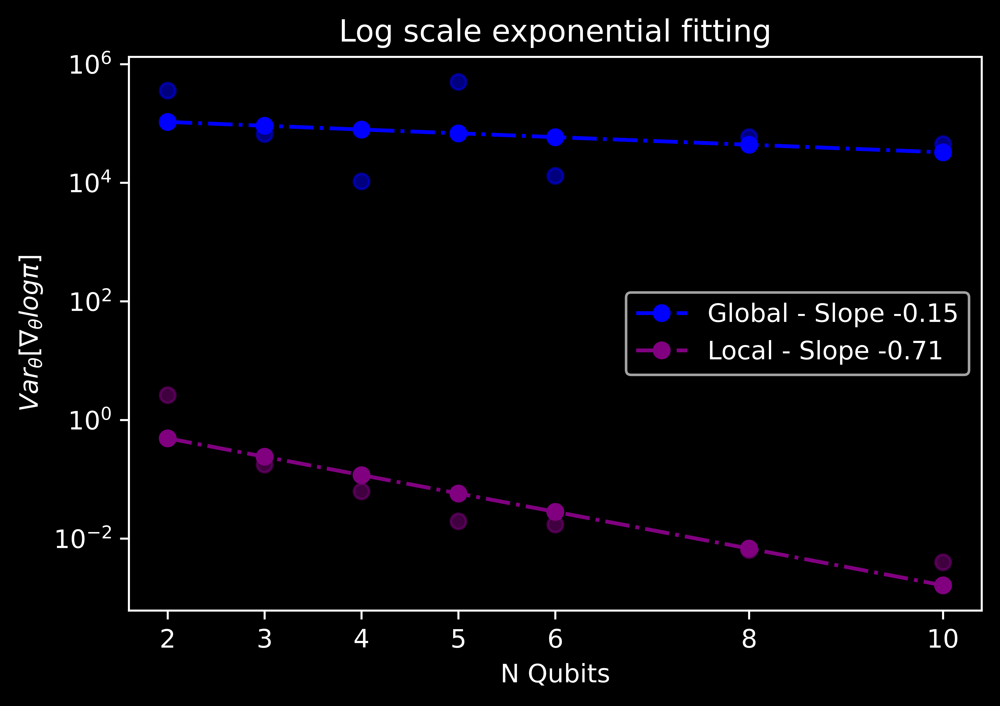

In [23]:
p = np.polyfit(qubits, np.log(variances_global), 1)
p2 = np.polyfit(qubits, np.log(variances_local), 1)

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
plt.semilogy(qubits, variances_global, "o" , color="blue" , alpha=0.5)
plt.semilogy(qubits, np.exp(p[0] * qubits + p[1]), "o-.", color="blue", label="Global - Slope {:3.2f}".format(p[0]))
plt.semilogy(qubits, variances_local, "o" , color="purple", alpha=0.5)
plt.semilogy(qubits,  np.exp(p2[0] * qubits + p2[1]), "o-.", color="purple", label="Local - Slope {:3.2f}".format(p2[0]))
plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.legend()
plt.title("Log scale exponential fitting")
plt.show()

## Strongly Entangling Layers with multiple layers <a name="SELLayers"></a>

In [106]:
import numpy as np
import pennylane as qml
import multiprocessing
import matplotlib.pyplot as plt
from helper_s2d import calculate_variances_sel

qubits = [2, 4, 6, 8, 10, 12]
layers = [2,3,4,5]
num_samples = 1000

variances_global_layers = []
variances_local_layers = []
exp_global_layers = []
exp_local_layers = []

for l in layers:
    print("-number of layers - ", l)
    with multiprocessing.Pool() as pool:
        results = pool.starmap(calculate_variances_sel, [(l, n_qubits, num_samples) for n_qubits in qubits])

    variances_global, variances_local, exp_global, exp_local = zip(*results)
    variances_global_layers.append(variances_global)
    variances_local_layers.append(variances_local)
    exp_global_layers.append(exp_global)
    exp_local_layers.append(exp_local)

qubits = np.array(qubits)

-number of layers -  2
---Doing #qubits - 2
---Doing #qubits - 12
---Doing #qubits - 10
---Doing #qubits - 6
---Doing #qubits - 8
---Doing #qubits - 4
-number of layers -  3
---Doing #qubits - 2
---Doing #qubits - 6
---Doing #qubits - 8
---Doing #qubits - 12
---Doing #qubits - 4
---Doing #qubits - 10
-number of layers -  4
---Doing #qubits - 2
---Doing #qubits - 4
---Doing #qubits - 10
---Doing #qubits - 8
---Doing #qubits - 12
---Doing #qubits - 6
-number of layers -  5
---Doing #qubits - 4
---Doing #qubits - 12
---Doing #qubits - 2
---Doing #qubits - 8
---Doing #qubits - 6
---Doing #qubits - 10


np.save("born_num_experiments_data/SEL_var_global.npy", variances_global_layers)
np.save("born_num_experiments_data/SEL_var_local.npy", variances_local_layers)
np.save("born_num_experiments_data/SEL_exp_global.npy", exp_global_layers)
np.save("born_num_experiments_data/SEL_exp_local.npy", exp_local_layers)

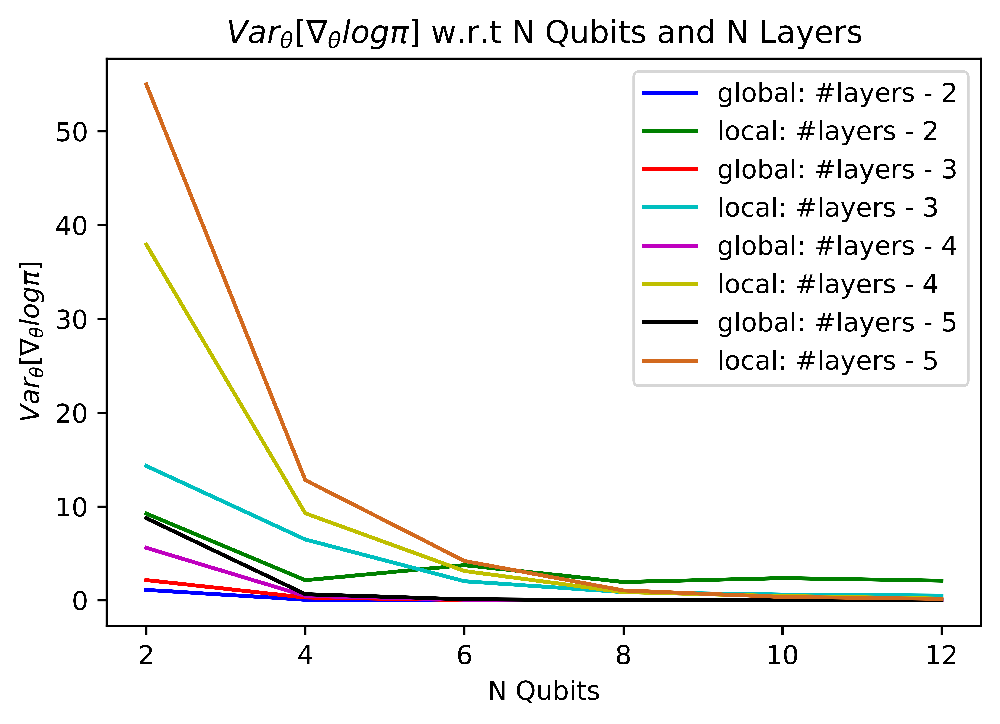

In [107]:
qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
colors = ['b','g','r','c','m','y','k','chocolate']
c=0
for l in range(len(layers)):

    plt.plot(qubits, variances_global_layers[l], color=colors[c], label="global: #layers - {}".format(l+2))
    plt.plot(qubits, variances_local_layers[l], color=colors[c+1], label="local: #layers - {}".format(l+2))
    c+=2

plt.legend()
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits and N Layers")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits")
plt.show()

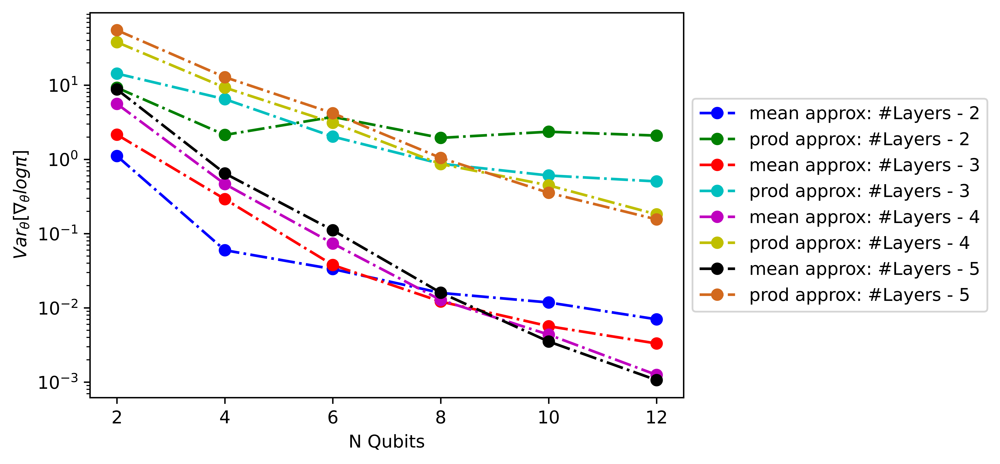

In [117]:
pg=[]
pl=[]
for l in range(len(layers)):
    pg.append(np.polyfit(qubits, variances_global_layers[l], 5))
    #pg.append(np.polyfit(qubits, np.log(variances_global_layers[l]), 1))
    pl.append(np.polyfit(qubits, variances_local_layers[l], 5))

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)):

    plt.semilogy(qubits, variances_global_layers[l], "o" ,color=colors[count], alpha=0.5)
    plt.semilogy(qubits, np.polyval(pg[l],qubits), "o-.",color=colors[count],label="mean approx: #Layers - {}".format(l+2))#- Slope {:3.2f}".format(l+2,pg[l][0]))
    #plt.semilogy(qubits,  np.exp(pg[l][0] * qubits + pg[l][1]), "o-.", color=colors[count],label="Local: #Layers - {} - Slope {:3.2f}".format(l+2,pl[l][0]))

    count+=1
    plt.semilogy(qubits, variances_local_layers[l], "o" , color=colors[count], alpha=0.5)
    #plt.semilogy(qubits,  np.exp(pl[l][0] * qubits + pl[l][1]), "o-.", color=colors[count],label="Local: #Layers - {} - Slope {:3.2f}".format(l+2,pl[l][0]))
    plt.semilogy(qubits,  np.polyval(pl[l],qubits), "o-.", color=colors[count],label="prod approx: #Layers - {}".format(l+2))# - Slope {:3.2f}".format(l+2,pl[l][0]))
    count+=1

plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.title("Log scale exponential fitting")
plt.show()

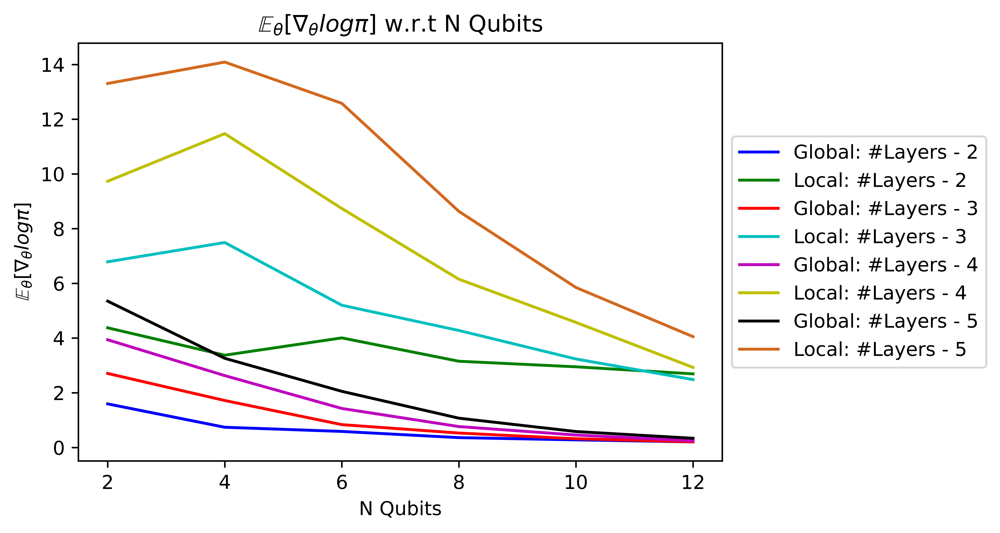

In [103]:
qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)):

    plt.plot(qubits, exp_global_layers[l],color=colors[count], label="Global: #Layers - {}".format(l+2))
    plt.plot(qubits, exp_local_layers[l], color=colors[count+1], label="Local: #Layers - {}".format(l+2))
    count+=2

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

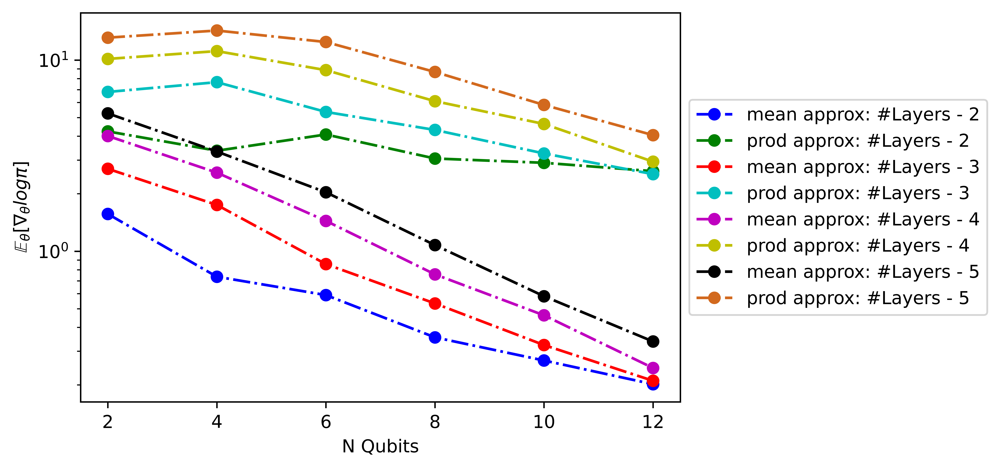

In [116]:
pg=[]
pl=[]
for l in range(len(layers)):
    pg.append(np.polyfit(qubits, exp_global_layers[l], 5))
    #pl.append(np.polyfit(qubits, np.log(exp_local_layers[l]), 1))
    pl.append(np.polyfit(qubits, exp_local_layers[l], 5))

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)):

    plt.semilogy(qubits, exp_global_layers[l], "o" ,color=colors[count], alpha=0.5)
    plt.semilogy(qubits, np.polyval(pg[l],qubits), "o-.",color=colors[count],label="mean approx: #Layers - {}".format(l+2))# - Slope {:3.2f}".format(l+2,pg[l][0]))
    count+=1
    plt.semilogy(qubits, exp_local_layers[l], "o" , color=colors[count], alpha=0.5)
    #plt.semilogy(qubits,  np.exp(pl[l][0] * qubits + pl[l][1]), "o-.", color=colors[count],label="Local: #Layers - {} - Slope {:3.2f}".format(l+2,pl[l][0]))
    plt.semilogy(qubits,  np.polyval(pl[l],qubits), "o-.", color=colors[count],label="prod approx: #Layers - {}".format(l+2))# - Slope {:3.2f}".format(l+2,pl[l][0]))
    count+=1

plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.title("Log scale exponential fitting")
plt.show()

In [115]:
np.save("SEL_var_global_U(-pi,pi)_sum.npy", variances_global_layers)
np.save("SEL_var_local_U(-pi,pi)_prod.npy", variances_local_layers)
np.save("SEL_exp_global_U(-pi,pi)_sum.npy", exp_global_layers)
np.save("SEL_exp_local_U(-pi,pi)_prod.npy", exp_local_layers)

### Random circuit product 

In [1]:
import numpy as np
import pennylane as qml
import multiprocessing
import matplotlib.pyplot as plt
from helper_s2d import calculate_variances_random_product

qubits = [2, 4, 6, 8, 10, 12]
layers = [2,3,4,5,6,7,8]
num_samples = 500

variances_global_layers = []
variances_local_layers = []
exp_global_layers = []
exp_local_layers = []

for l in layers:
    print("-number of layers - ", l)
    with multiprocessing.Pool() as pool:
        results = pool.starmap(calculate_variances_random_product, [(l, n_qubits, num_samples) for n_qubits in qubits])

    variances_global, variances_local, exp_global, exp_local = zip(*results)
    variances_global_layers.append(variances_global)
    variances_local_layers.append(variances_local)
    exp_global_layers.append(exp_global)
    exp_local_layers.append(exp_local)

qubits = np.array(qubits)

-number of layers -  2
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 10
---Doing #qubits - 2
---Doing #qubits - 4
---Doing #qubits - 8
-number of layers -  3
---Doing #qubits - 6
---Doing #qubits - 4
---Doing #qubits - 8
---Doing #qubits - 12
---Doing #qubits - 2
---Doing #qubits - 10
-number of layers -  4
---Doing #qubits - 2
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 8
---Doing #qubits - 4
---Doing #qubits - 10
-number of layers -  5
---Doing #qubits - 8
---Doing #qubits - 6
---Doing #qubits - 2
---Doing #qubits - 12
---Doing #qubits - 10
---Doing #qubits - 4
-number of layers -  6
---Doing #qubits - 2
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 10
---Doing #qubits - 8
---Doing #qubits - 4
-number of layers -  7
---Doing #qubits - 4
---Doing #qubits - 12
---Doing #qubits - 6
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 2
-number of layers -  8
---Doing #qubits - 6
---Doing #qubits - 10
---Doing #qubits - 4
---Doin

In [2]:
np.save("RANDOM_product_var_global_U(-pi,pi)_sum.npy", variances_global_layers)
np.save("RANDOM_product_var_local_U(-pi,pi)_prod.npy", variances_local_layers)
np.save("RANDOM_product_exp_global_U(-pi,pi)_sum.npy", exp_global_layers)
np.save("RANDOM_product_exp_local_U(-pi,pi)_prod.npy", exp_local_layers)

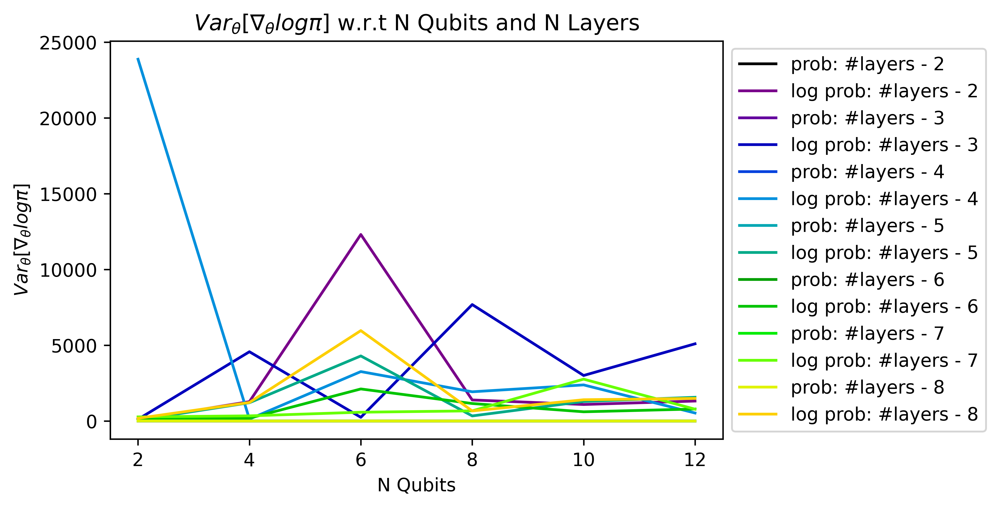

In [12]:
import matplotlib.cm as cm

qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 600
plt.rcParams['savefig.dpi'] = 600
colors = ['b','g','r','c','m','y','k','chocolate','darkblue','darkorange']
c=0

cmap = cm.get_cmap('nipy_spectral')  # Can change to any colormap you like


variances_global_layers = np.array(variances_global_layers)
variances_local_layers = np.array(variances_local_layers)
for l in range(len(layers)):
    color = cmap(c / len(variances_global_layers)/2.5)
    plt.plot(qubits, variances_global_layers[l],color=color, label="prob: #layers - {}".format(layers[l]))
    c+=1
    color = cmap(c / len(variances_global_layers)/2.5)
    plt.plot(qubits, variances_local_layers[l], color=color,label="log prob: #layers - {}".format(layers[l]))
    c+=1

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits and N Layers")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits")
plt.show()

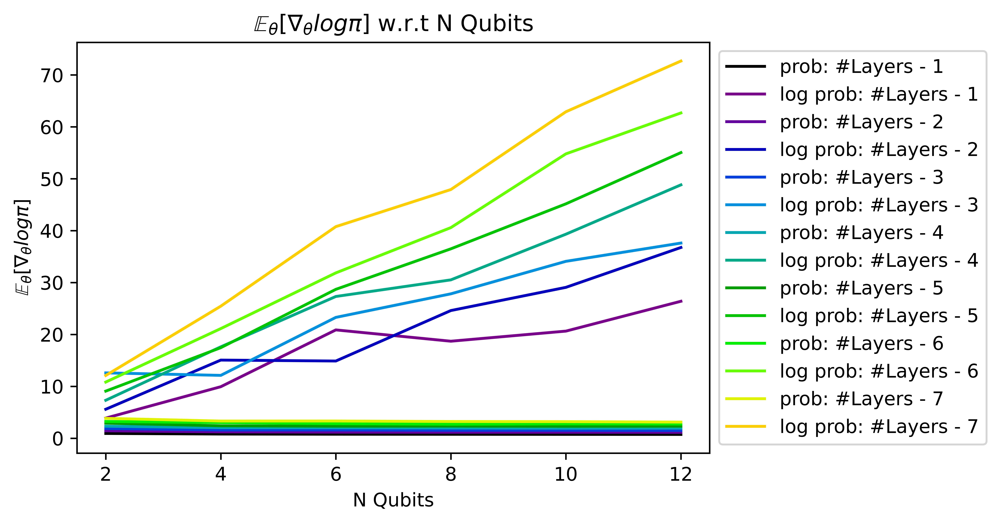

In [13]:
qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate','darkblue','darkorange']
c=0
for l in range(len(layers)):

    color = cmap(c / len(variances_global_layers)/2.5)

    plt.plot(qubits, exp_global_layers[l],color=color, label="prob: #Layers - {}".format(l+1))
    
    c+=1
    color = cmap(c / len(variances_global_layers)/2.5)
   
    plt.plot(qubits, exp_local_layers[l], color=color, label="log prob: #Layers - {}".format(l+1))
    c+=1

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

### Random product state and global expectation value

In [1]:
import numpy as np
import pennylane as qml
import multiprocessing
import matplotlib.pyplot as plt
from helper_s2d import calculate_variances_random_product_expval

qubits = [2, 4, 6, 8, 10, 12]
layers = [2,3,4,5,6,7,8]
num_samples = 500

variances_global_layers = []
variances_local_layers = []
exp_global_layers = []
exp_local_layers = []

for l in layers:
    print("-number of layers - ", l)
    with multiprocessing.Pool() as pool:
        results = pool.starmap(calculate_variances_random_product_expval, [(l, n_qubits, num_samples) for n_qubits in qubits])

    variances_global, exp_global = zip(*results)
    variances_global_layers.append(variances_global)
    exp_global_layers.append(exp_global)

qubits = np.array(qubits)

-number of layers -  2
---Doing #qubits - 2
---Doing #qubits - 12
---Doing #qubits - 4
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 6
-number of layers -  3
---Doing #qubits - 2
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 4
---Doing #qubits - 8
---Doing #qubits - 10
-number of layers -  4
---Doing #qubits - 4
---Doing #qubits - 2
---Doing #qubits - 10
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 8
-number of layers -  5
---Doing #qubits - 2
---Doing #qubits - 6
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 4
---Doing #qubits - 12
-number of layers -  6
---Doing #qubits - 4
---Doing #qubits - 2
---Doing #qubits - 12
---Doing #qubits - 10
---Doing #qubits - 6
---Doing #qubits - 8
-number of layers -  7
---Doing #qubits - 2
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 6
---Doing #qubits - 4
---Doing #qubits - 12
-number of layers -  8
---Doing #qubits - 6
---Doing #qubits - 10
---Doing #qubits - 12
---Doi

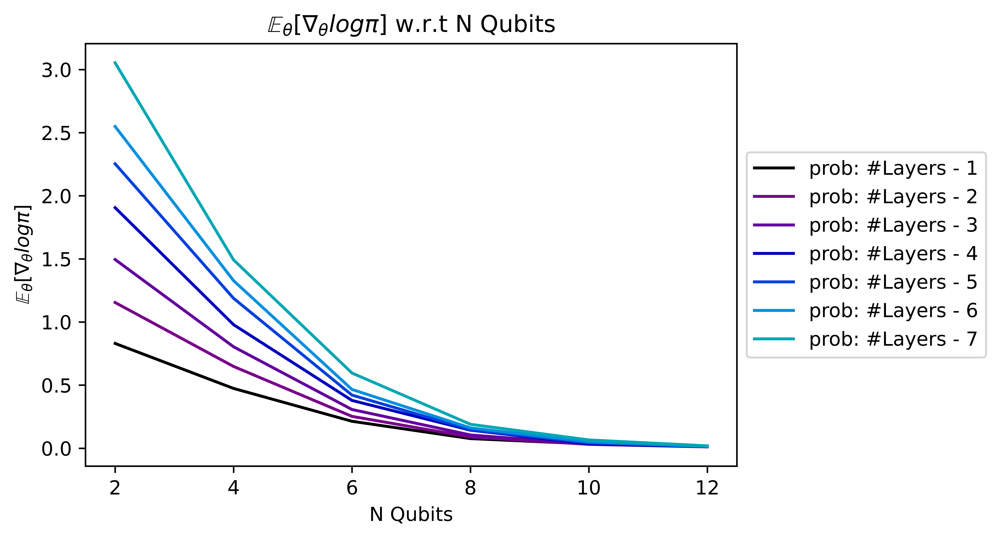

In [5]:
import matplotlib.cm as cm

cmap = cm.get_cmap('nipy_spectral')  # Can change to any colormap you like

qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate','darkblue','darkorange']
c=0
for l in range(len(layers)):

    color = cmap(c / len(variances_global_layers)/2.5)

    plt.plot(qubits, exp_global_layers[l],color=color, label="prob: #Layers - {}".format(l+1))
    
    c+=1
    color = cmap(c / len(variances_global_layers)/2.5)
   
    #plt.plot(qubits, exp_local_layers[l], color=color, label="log prob: #Layers - {}".format(l+1))
    #c+=1

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

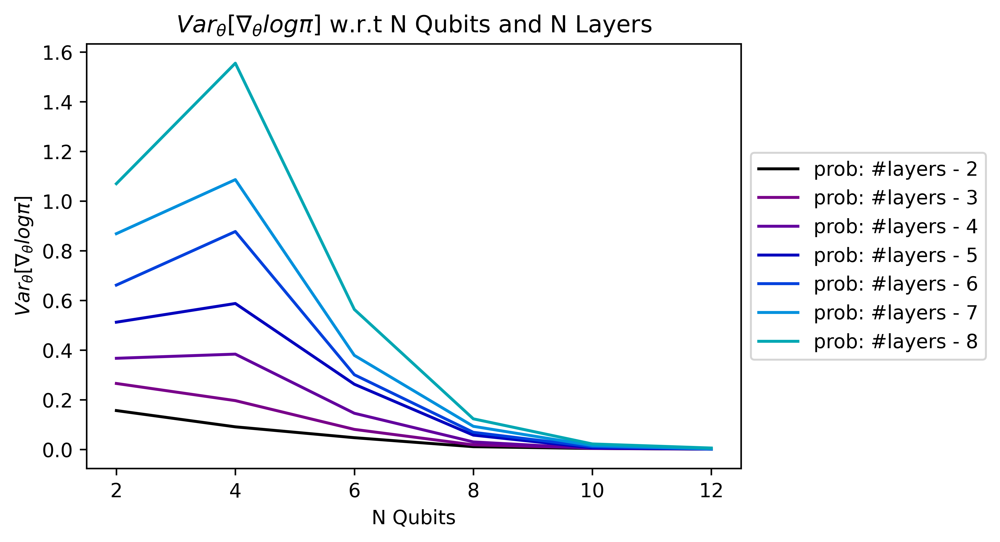

In [6]:
import matplotlib.cm as cm

qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 600
plt.rcParams['savefig.dpi'] = 600
colors = ['b','g','r','c','m','y','k','chocolate','darkblue','darkorange']
c=0

cmap = cm.get_cmap('nipy_spectral')  # Can change to any colormap you like


variances_global_layers = np.array(variances_global_layers)
for l in range(len(layers)):
    color = cmap(c / len(variances_global_layers)/2.5)
    plt.plot(qubits, variances_global_layers[l],color=color, label="prob: #layers - {}".format(layers[l]))
    c+=1

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits and N Layers")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits")
plt.show()

## Random circuit with multiple layers <a name="randomlayers"></a>


In [10]:
import numpy as np
import pennylane as qml
import multiprocessing
import matplotlib.pyplot as plt
from helper_s2d import calculate_variances_random

qubits = [2, 4, 6, 8, 10, 12]
layers = [2,3,4,5]
num_samples = 500

variances_global_layers = []
variances_local_layers = []
exp_global_layers = []
exp_local_layers = []

for l in layers:
    print("-number of layers - ", l)
    with multiprocessing.Pool() as pool:
        results = pool.starmap(calculate_variances_random, [(l, n_qubits, num_samples) for n_qubits in qubits])

    variances_global, variances_local, exp_global, exp_local = zip(*results)
    variances_global_layers.append(variances_global)
    variances_local_layers.append(variances_local)
    exp_global_layers.append(exp_global)
    exp_local_layers.append(exp_local)

qubits = np.array(qubits)

-number of layers -  2
---Doing #qubits - 2
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 4
-number of layers -  3
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 4
---Doing #qubits - 2
-number of layers -  4
---Doing #qubits - 2
---Doing #qubits - 4
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 12
---Doing #qubits - 6
-number of layers -  5
---Doing #qubits - 6
---Doing #qubits - 2
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 12
---Doing #qubits - 4


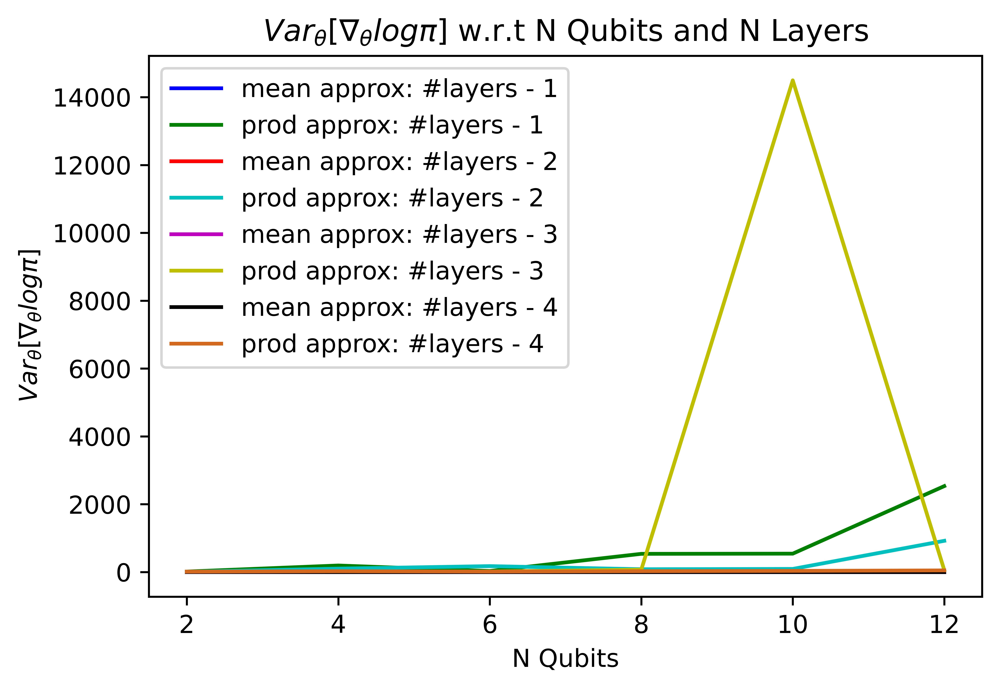

In [11]:
qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
colors = ['b','g','r','c','m','y','k','chocolate','darkblue','darkorange']
c=0
for l in range(len(layers)):

    plt.plot(qubits, variances_global_layers[l], color=colors[c], label="mean approx: #layers - {}".format(l+1))
    plt.plot(qubits, variances_local_layers[l], color=colors[c+1], label="prod approx: #layers - {}".format(l+1))
    c+=2

plt.legend()
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits and N Layers")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits")
plt.show()

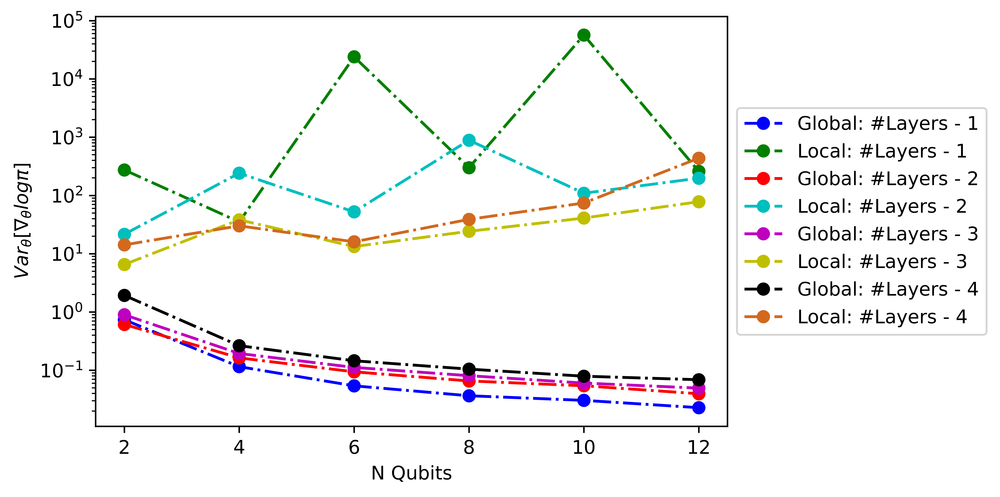

In [33]:
pg=[]
pl=[]
variances_global_layers=np.load("born_num_experiments_data/random_var_mean_U(-pi,pi).npy")
variances_local_layers=np.load("born_num_experiments_data/random_var_prod_U(-pi,pi).npy")
exp_global_layers=np.load("born_num_experiments_data/random_exp_mean_U(-pi,pi).npy")
exp_local_layers=np.load("born_num_experiments_data/random_exp_prod_U(-pi,pi).npy")

for l in range(len(layers)):
    #pg.append(np.polyfit(qubits, np.log(variances_global_layers[l]), 1))
    #pl.append(np.polyfit(qubits, np.log(variances_local_layers[l]), 1))
    pg.append(np.polyfit(qubits, variances_global_layers[l], 5))
    pl.append(np.polyfit(qubits, variances_local_layers[l], 5))

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate','darkblue','darkorange']
count=0
for l in range(len(layers)):

    plt.semilogy(qubits, variances_global_layers[l], "o" ,color=colors[count], alpha=0.5)
    #plt.semilogy(qubits, np.exp(pg[l][0] * qubits + pg[l][1]), "o-.",color=colors[count],label="Global: #Layers - {} - Slope {:3.2f}".format(l+1,pg[l][0]))
    plt.semilogy(qubits, np.polyval(pg[l],qubits), "o-.",color=colors[count],label="Global: #Layers - {}".format(l+1))
    count+=1
    plt.semilogy(qubits, variances_local_layers[l], "o" , color=colors[count], alpha=0.5)
    #plt.semilogy(qubits,  np.exp(pl[l][0] * qubits + pl[l][1]), "o-.", color=colors[count],label="Local: #Layers - {} - Slope {:3.2f}".format(l+1,pl[l][0]))
    plt.semilogy(qubits,  np.polyval(pl[l],qubits), "o-.", color=colors[count],label="Local: #Layers - {}".format(l+1))
    count+=1

plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.title("Log scale exponential fitting")
plt.show()

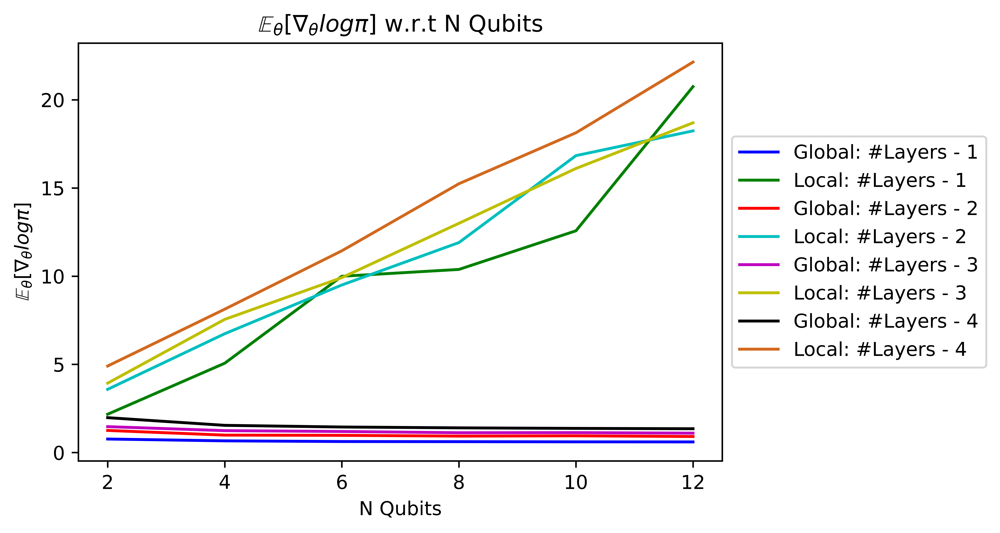

In [19]:
qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate','darkblue','darkorange']
count=0
for l in range(len(layers)):

    plt.plot(qubits, exp_global_layers[l],color=colors[count], label="Global: #Layers - {}".format(l+1))
    plt.plot(qubits, exp_local_layers[l], color=colors[count+1], label="Local: #Layers - {}".format(l+1))
    count+=2

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

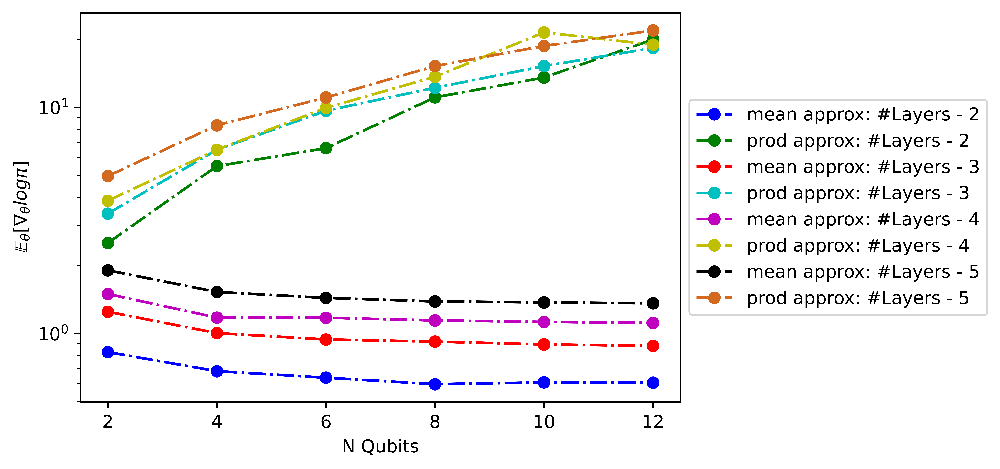

In [14]:
pg=[]
pl=[]
for l in range(len(layers)):
    pg.append(np.polyfit(qubits, exp_global_layers[l], 5))
    #pl.append(np.polyfit(qubits, np.log(exp_local_layers[l]), 1))
    pl.append(np.polyfit(qubits, exp_local_layers[l], 5))

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)):

    plt.semilogy(qubits, exp_global_layers[l], "o" ,color=colors[count], alpha=0.5)
    plt.semilogy(qubits, np.polyval(pg[l],qubits), "o-.",color=colors[count],label="mean approx: #Layers - {}".format(l+2))# - Slope {:3.2f}".format(l+2,pg[l][0]))
    count+=1
    plt.semilogy(qubits, exp_local_layers[l], "o" , color=colors[count], alpha=0.5)
    #plt.semilogy(qubits,  np.exp(pl[l][0] * qubits + pl[l][1]), "o-.", color=colors[count],label="Local: #Layers - {} - Slope {:3.2f}".format(l+2,pl[l][0]))
    plt.semilogy(qubits,  np.polyval(pl[l],qubits), "o-.", color=colors[count],label="prod approx: #Layers - {}".format(l+2))# - Slope {:3.2f}".format(l+2,pl[l][0]))
    count+=1

plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.title("Log scale exponential fitting")
plt.show()

In [7]:
np.save("born_num_experiments_data/random_var_mean_U(-pi,pi).npy", variances_global_layers)
np.save("born_num_experiments_data/random_var_prod_U(-pi,pi).npy", variances_local_layers)
np.save("born_num_experiments_data/random_exp_mean_U(-pi,pi).npy", exp_global_layers)
np.save("born_num_experiments_data/random_exp_prod_U(-pi,pi).npy", exp_local_layers)

## 7. Simplified two-design
<a name="general-2-design"></a>

In [24]:
import numpy as np
import pennylane as qml
import multiprocessing
import matplotlib.pyplot as plt
from helper_s2d import calculate_variances_s2d

qubits = [2, 4, 6, 8, 10, 12]
layers = [2,3,4,5]
num_samples = 500

variances_global_layers = []
variances_local_layers = []
exp_global_layers = []
exp_local_layers = []

for l in layers:
    print("-number of layers - ", l)
    with multiprocessing.Pool() as pool:
        results = pool.starmap(calculate_variances_random, [(l, n_qubits, num_samples) for n_qubits in qubits])

    variances_global, variances_local, exp_global, exp_local = zip(*results)
    variances_global_layers.append(variances_global)
    variances_local_layers.append(variances_local)
    exp_global_layers.append(exp_global)
    exp_local_layers.append(exp_local)

qubits = np.array(qubits)

-number of layers -  2
---Doing #qubits - 10
---Doing #qubits - 4
---Doing #qubits - 6
---Doing #qubits - 2
---Doing #qubits - 8
---Doing #qubits - 12
-number of layers -  3
---Doing #qubits - 6
---Doing #qubits - 2
---Doing #qubits - 10
---Doing #qubits - 4
---Doing #qubits - 8
---Doing #qubits - 12
-number of layers -  4
---Doing #qubits - 12
---Doing #qubits - 6
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 4
---Doing #qubits - 2
-number of layers -  5
---Doing #qubits - 4
---Doing #qubits - 8
---Doing #qubits - 10
---Doing #qubits - 6
---Doing #qubits - 12
---Doing #qubits - 2


In [31]:
np.save("BORN_SD2_var_global_U(-pi,pi)",variances_global_layers)
np.save("BORN_SD2_var_local_U(-pi,pi)",variances_local_layers)
np.save("BORN_SD2_exp_global_U(-pi,pi)",exp_global_layers)
np.save("BORN_SD2_exp_local_U(-pi,pi)",exp_local_layers)

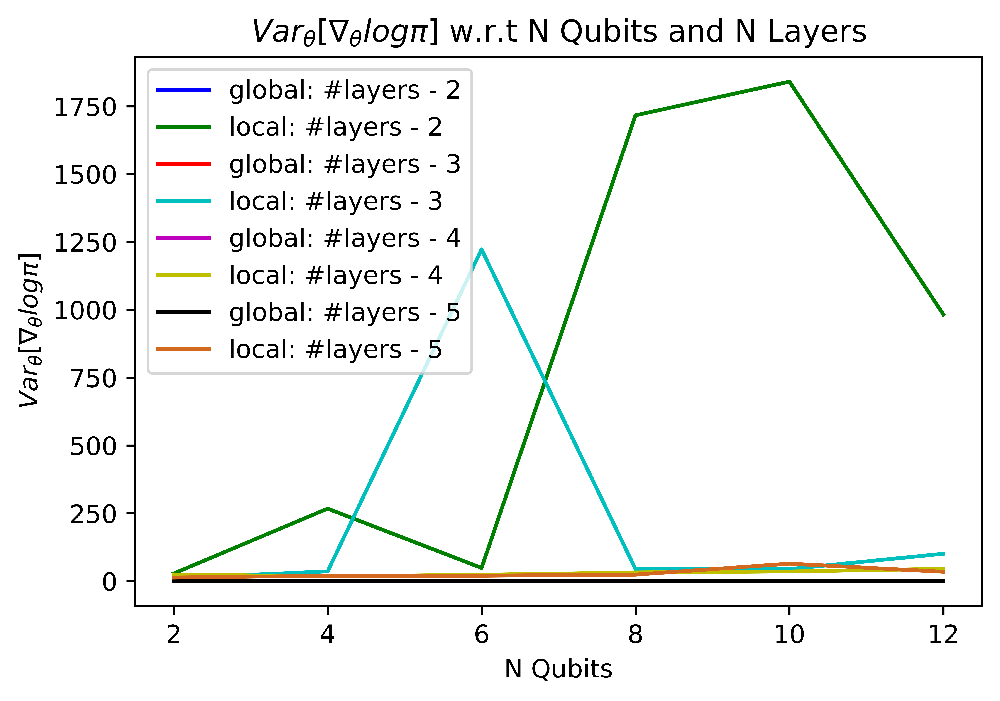

In [25]:
qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
colors = ['b','g','r','c','m','y','k','chocolate']
c=0
for l in range(len(layers)):

    plt.plot(qubits, variances_global_layers[l], color=colors[c], label="global: #layers - {}".format(l+2))
    plt.plot(qubits, variances_local_layers[l], color=colors[c+1], label="local: #layers - {}".format(l+2))
    c+=2

plt.legend()
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits and N Layers")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits")
plt.show()

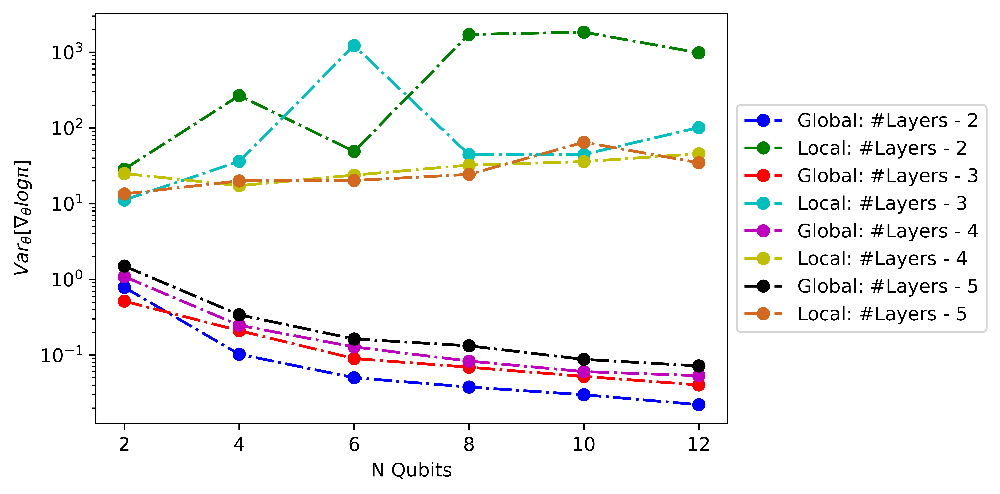

In [30]:
pg=[]
pl=[]
for l in range(len(layers)):
    pg.append(np.polyfit(qubits, variances_global_layers[l], 5))
    #pl.append(np.polyfit(qubits, np.log(variances_local_layers[l]), 1))
    pl.append(np.polyfit(qubits, variances_local_layers[l], 5))

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)):

    plt.semilogy(qubits, variances_global_layers[l], "o" ,color=colors[count], alpha=0.5)
    plt.semilogy(qubits, np.polyval(pg[l],qubits), "o-.",color=colors[count],label="Global: #Layers - {}".format(l+2))
    count+=1
    plt.semilogy(qubits, variances_local_layers[l], "o" , color=colors[count], alpha=0.5)
    #plt.semilogy(qubits,  np.exp(pl[l][0] * qubits + pl[l][1]), "o-.", color=colors[count],label="Local: #Layers - {} - Slope {:3.2f}".format(l+2,pl[l][0]))
    plt.semilogy(qubits,  np.polyval(pl[l],qubits), "o-.", color=colors[count],label="Local: #Layers - {}".format(l+2))
    count+=1

plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.title("Log scale fitting")
plt.show()

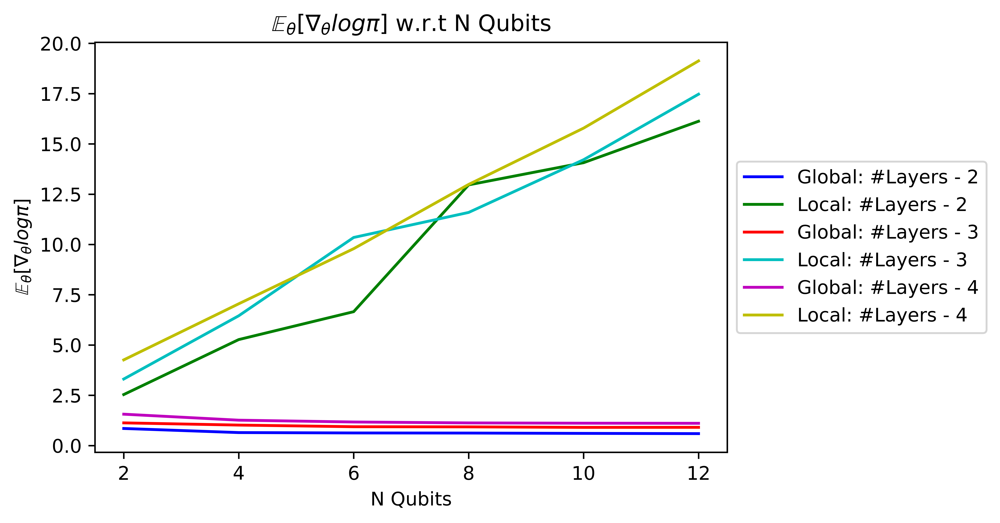

In [28]:
qubits = np.array(qubits)
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)-1):

    plt.plot(qubits, exp_global_layers[l],color=colors[count], label="Global: #Layers - {}".format(l+2))
    plt.plot(qubits, exp_local_layers[l], color=colors[count+1], label="Local: #Layers - {}".format(l+2))
    count+=2

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("N Qubits")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ w.r.t N Qubits")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.show()

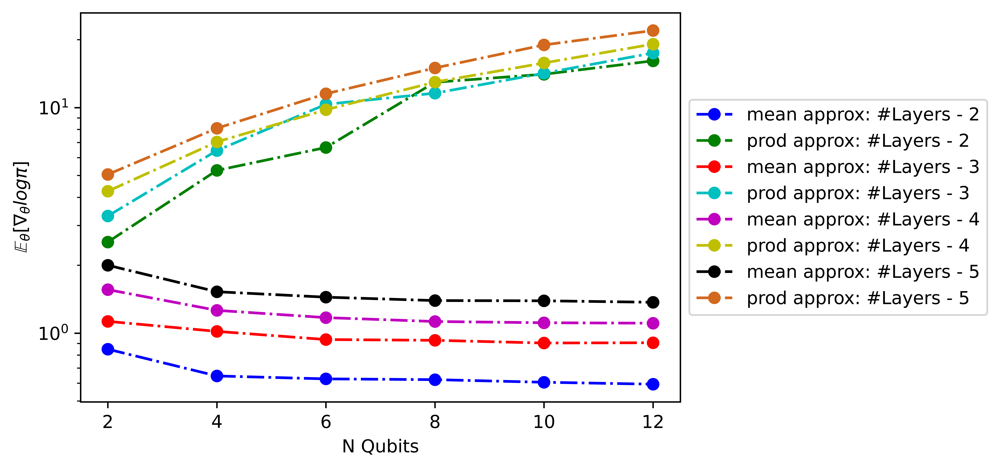

In [17]:
variances_global_layers = np.load("BORN_SD2_var_global_U(-pi,pi).npy")
variances_local_layers = np.load("BORN_SD2_var_local_U(-pi,pi).npy")
exp_global_layers = np.load("BORN_SD2_exp_global_U(-pi,pi).npy")
exp_local_layers = np.load("BORN_SD2_exp_local_U(-pi,pi).npy")
qubits = [2, 4, 6, 8, 10, 12]
layers = [2,3,4,5]
pg=[]
pl=[]
for l in range(len(layers)):
    pg.append(np.polyfit(qubits, exp_global_layers[l], 5))
    #pl.append(np.polyfit(qubits, np.log(exp_local_layers[l]), 1))
    pl.append(np.polyfit(qubits, exp_local_layers[l], 5))

# Plot the straight line fit to the semilog
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)):

    plt.semilogy(qubits, exp_global_layers[l], "o" ,color=colors[count], alpha=0.5)
    plt.semilogy(qubits, np.polyval(pg[l],qubits), "o-.",color=colors[count],label="mean approx: #Layers - {}".format(l+2))
    count+=1
    plt.semilogy(qubits, exp_local_layers[l], "o" , color=colors[count], alpha=0.5)
    #plt.semilogy(qubits,  np.exp(pl[l][0] * qubits + pl[l][1]), "o-.", color=colors[count],label="Local: #Layers - {} - Slope {:3.2f}".format(l+2,pl[l][0]))
    plt.semilogy(qubits,  np.polyval(pl[l],qubits), "o-.", color=colors[count],label="prod approx: #Layers - {}".format(l+2))
    count+=1

plt.xlabel(r"N Qubits")
plt.xticks(qubits)
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.title("Log scale fitting")
plt.show()

## Joint plot

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

colors = ['red', 'blue', 'green', 'purple', 'orange', 'cyan']
layers = [2,3,4,5]
qubits = [2,4,6,8,10,12]
pg_total = []
pl_total = []

variances_global_layers_s2d = np.load("BORN_SD2_var_global_U(-pi,pi).npy")
variances_local_layers_s2d = np.load("BORN_SD2_var_local_U(-pi,pi).npy")
variances_global_layers_sel = np.load("SEL_var_global_U(-pi,pi)_sum.npy")
variances_local_layers_sel = np.load("SEL_var_local_U(-pi,pi)_prod.npy")
variances_global_layers_random = np.load("born_num_experiments_data/random_var_mean_U(-pi,pi).npy")
variances_local_layers_random = np.load("born_num_experiments_data/random_var_prod_U(-pi,pi).npy")
variances_global_layers = []
variances_global_layers.append(variances_global_layers_s2d)
variances_global_layers.append(variances_global_layers_sel)
variances_global_layers.append(variances_global_layers_random)
variances_local_layers = []
variances_local_layers.append(variances_local_layers_s2d)
variances_local_layers.append(variances_local_layers_sel)
variances_local_layers.append(variances_local_layers_random)

images=[]
image_s2d = Image.open('/Users/andresequeira/Desktop/bp_qpg_PART_I/images/S2d_ansatz.png')
image_sel = Image.open('/Users/andresequeira/Desktop/bp_qpg_PART_I/images/sel.png')
image_random = Image.open('/Users/andresequeira/Desktop/bp_qpg_PART_I/images/random circuit.png')
images.append(image_s2d)
images.append(image_sel)
images.append(image_random)

for i in range(3):

    pg = []
    pl = []

    for l in range(len(layers)):
        #pg.append(np.polyfit(qubits, np.log(variances_global_layers[i][l]), 1))
        pg.append(np.polyfit(qubits, variances_global_layers[i][l], 10))
        pl.append(np.polyfit(qubits, variances_local_layers[i][l], 10))

    pg_total.append(pg)
    pl_total.append(pl)

plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200

fig, axes = plt.subplots(1, 3, figsize=(12, 5), dpi=1200)

for i, ax in enumerate(axes):
    for l in range(len(layers)):
        #if i == 2 and l==0:
            #continue

        ax.semilogy(qubits, variances_global_layers[i][l], "o", color=colors[l % len(colors)], alpha=0.5)
        #ax.semilogy(qubits, np.exp(pg_total[i][l][0] * np.array(qubits) + pg_total[i][l][1]), "o-", color=colors[l % len(colors)], label="Global: #Layers - {}".format(layers[l]))
        ax.semilogy(qubits, np.polyval(pg_total[i][l],qubits) , "o-", color=colors[l % len(colors)], label="Mean approx: #Layers - {}".format(layers[l]))

        ax.semilogy(qubits, variances_local_layers[i][l], "o", color=colors[l % len(colors)], alpha=0.5)
        ax.semilogy(qubits, np.polyval(pl_total[i][l], qubits), "o--", color=colors[l % len(colors)], label="Prod approx: #Layers - {}".format(layers[l]))

        if i==0:
            inset_ax = inset_axes(ax, width="40%", height="40%", loc="upper right",bbox_to_anchor=(-0.1,-0.4, 1,1), bbox_transform=ax.transAxes, borderpad=0)
        elif i==1:
            inset_ax = inset_axes(ax, width="70%", height="60%", loc="upper right",bbox_to_anchor=(-0.05,0.18, 1,1), bbox_transform=ax.transAxes, borderpad=0)
        elif i==2:
            inset_ax = inset_axes(ax, width="50%", height="50%", loc="upper right",bbox_to_anchor=(-0.05,-0.45,1,1), bbox_transform=ax.transAxes, borderpad=0)
            
        # Display the image in the inset_axes
        inset_ax.imshow(images[i])
        # Remove ticks and labels from the inset_axes
        inset_ax.set_xticks([])
        inset_ax.set_yticks([])

    if i==0:
        ax.set_ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")

    ax.set_xlabel(r"N Qubits")
    ax.set_xticks(qubits)


axes[1].legend(bbox_to_anchor=(1.1, 0.5), loc='center right', borderaxespad=0, bbox_transform=fig.transFigure)
labels = ['(a)', '(b)', '(c)']
for i, ax in enumerate(axes):
    ax.text(0.05, 0.05, labels[i], transform=ax.transAxes, fontsize=16, fontweight='bold', va='bottom', ha='left')

#plt.tight_layout()
plt.show()


/opt/homebrew/Caskroom/miniforge/base/envs/quantum_DS/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/opt/homebrew/Caskroom/miniforge/base/envs/quantum_DS/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/opt/homebrew/Caskroom/miniforge/base/envs/quantum_DS/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/opt/homebrew/Caskroom/miniforge/base/envs/quantum_DS/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3398: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/opt/homebrew/Caskroom/miniforge/base/envs/quantum_DS/lib/python3.10/site-packages/IPython/core/interactiveshell.py:

# PART II - Generalized Born policies 
### Born policies with different partitions 


It is going to be tested different partitions from local to fully global measurement 
$$ \pi \leftarrow [[0], [0,1], [0,1,2] ... [0,1,2,...,\text{nqubits}-1]]$$

### 1. Simplified two-design 

In [26]:
import pennylane as qml
from pennylane import numpy as np
import torch 
import matplotlib.pyplot as plt
from numpy import linalg 

qbs = 12

qubits = list(range(1,qbs+1))
layers = [2,3,4,5]
variances_global = []
variances_local = []
exp_global=[]
exp_local=[]
variances_global_layers = []
variances_local_layers = []
exp_global_layers=[]
exp_local_layers=[]
num_samples = 1000
for l in layers:
    print("-number of layers - ",l)
    variances_global=[]
    variances_local=[]
    exp_global=[]
    exp_local=[] 
    for n_qubits in qubits:
        print("---measuring - qubits {}".format(list(range(n_qubits))))
        grad_vals_global = []
        grad_vals_local = []
        for i in range(num_samples):
            dev = qml.device("default.qubit", wires=qbs)

            @qml.qnode(dev, interface="torch", diff_method="backprop")
            def rand_circuit_global(init_weights,params):
                
                qml.SimplifiedTwoDesign(initial_layer_weights=init_weights, weights=params, wires=range(qbs))
                
                if n_qubits<qbs:
                    return qml.probs(wires=range(n_qubits))
                else:
                    return qml.probs(wires=range(qbs))
                
            def global_loss(init_weights, params):

                probs = rand_circuit_global(init_weights,params)

                if n_qubits<qbs:
                    pi_i = np.random.randint(2**n_qubits)
                    return torch.log(probs[pi_i])
                else:
                    return torch.log(torch.sum(probs[:int((2**qbs)/2)]))
                    
                
            shapes = qml.SimplifiedTwoDesign.shape(n_layers=l, n_wires=qbs)
            weights1 = np.random.uniform(low=-np.pi, high=np.pi, size=shapes[0])
            weights2 = np.random.uniform(low=-np.pi, high=np.pi, size=shapes[1])
            params11 = torch.tensor(weights1, requires_grad = True)
            params12 = torch.tensor(weights2, requires_grad = True)
            params21 = torch.tensor(weights1, requires_grad = True)
            params22 = torch.tensor(weights2, requires_grad = True)
            
            global_cost = global_loss(params11,params12)
            global_cost.backward()
            grad_vals_global.append((linalg.norm(params11.grad.numpy()) + linalg.norm(params12.grad.numpy()))/2)#grad_global))

        variances_global.append(np.var(grad_vals_global))
        exp_global.append(np.mean(grad_vals_global))
    variances_global_layers.append(variances_global)
    exp_global_layers.append(exp_global)

variances_global = np.array(variances_global)
qubits = np.array(qubits)

-number of layers -  2
---measuring - qubits [0]
---measuring - qubits [0, 1]
---measuring - qubits [0, 1, 2]
---measuring - qubits [0, 1, 2, 3]
---measuring - qubits [0, 1, 2, 3, 4]
---measuring - qubits [0, 1, 2, 3, 4, 5]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7, 8]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]
-number of layers -  3
---measuring - qubits [0]
---measuring - qubits [0, 1]
---measuring - qubits [0, 1, 2]
---measuring - qubits [0, 1, 2, 3]
---measuring - qubits [0, 1, 2, 3, 4]
---measuring - qubits [0, 1, 2, 3, 4, 5]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7, 8]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
---measuring - qubits [0, 1, 2, 3, 4, 5, 6, 7,

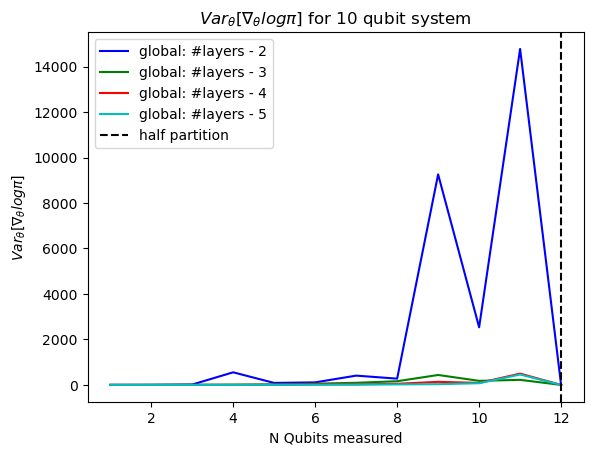

In [27]:

plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
#plt.style.use('dark_background')
plt.style.use('default')
colors = ['b','g','r','c','m','y','k','chocolate','violet',"purple"]
c=0
for l in range(len(layers)):

    plt.plot(qubits, variances_global_layers[l], color=colors[c], label="global: #layers - {}".format(l+2))
    c+=1

plt.axvline(qbs,color="black", linestyle="--", label="half partition")
plt.legend()
plt.title(r"$Var_\theta [\nabla_\theta log \pi]$ for 10 qubit system")
plt.ylabel(r"$Var_\theta [\nabla_\theta log \pi]$")
plt.xlabel("N Qubits measured")
name = 'local_global_and_partition_born/simplified2design_{}qubits_var_global.png'.format(qbs)
#plt.savefig(name)
plt.show()

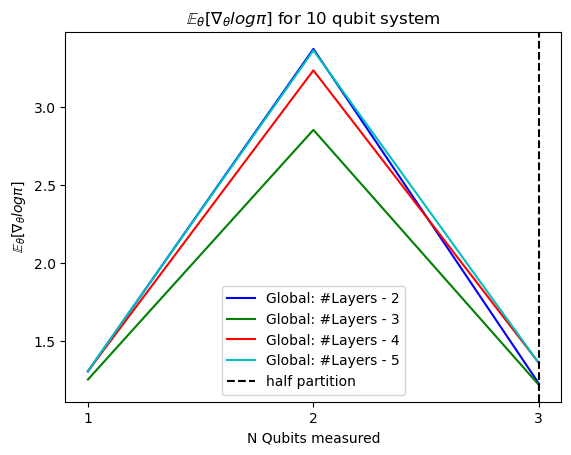

In [25]:
qubits = np.array(list(range(1,qbs+1)))
plt.rcParams['figure.dpi'] = 1200
plt.rcParams['savefig.dpi'] = 1200
#plt.style.use('dark_background')
plt.style.use('default')

colors = ['b','g','r','c','m','y','k','chocolate']
count=0
for l in range(len(layers)):

    plt.plot(qubits, exp_global_layers[l],color=colors[count], label="Global: #Layers - {}".format(l+2))
    count+=1

plt.axvline(qbs,color="black", linestyle="--", label="half partition")
plt.legend()#loc='center left', bbox_to_anchor=(1, 0.5))
plt.xlabel("N Qubits measured")
plt.xticks(qubits)
plt.title(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$ for 10 qubit system")
plt.ylabel(r"$\mathbb{E}_\theta [\nabla_\theta log \pi]$")
name = 'local_global_and_partition_born/simplified2design_{}qubits_ex_global.png'.format(qbs)
plt.savefig(name)
plt.show()

In [ ]:
np.save("local_global_and_partition_born/simplified2design_{}qubits_var_global.npy".format(qbs), variances_global_layers)
np.save("local_global_and_partition_born/simplified2design_{}qubits_exp_global.npy".format(qbs), exp_global_layers)

### Ciao for now ! :)